# Deep Convolutional GANs

In this notebook, you'll build a GAN using convolutional layers in the generator and discriminator. This is called a Deep Convolutional GAN, or DCGAN for short. The DCGAN architecture was first explored last year and has seen impressive results in generating new images, you can read the [original paper here](https://arxiv.org/pdf/1511.06434.pdf).

You'll be training DCGAN on the [Street View House Numbers](http://ufldl.stanford.edu/housenumbers/) (SVHN) dataset. These are color images of house numbers collected from Google street view. SVHN images are in color and much more variable than MNIST. 

![SVHN Examples](assets/SVHN_examples.png)

So, we'll need a deeper and more powerful network. This is accomplished through using convolutional layers in the discriminator and generator. It's also necessary to use batch normalization to get the convolutional networks to train. The only real changes compared to what [you saw previously](https://github.com/udacity/deep-learning/tree/master/gan_mnist) are in the generator and discriminator, otherwise the rest of the implementation is the same.

In [1]:
%matplotlib inline

import pickle as pkl

import matplotlib.pyplot as plt
import numpy as np
from scipy.io import loadmat
import tensorflow as tf

In [2]:
!mkdir data

mkdir: cannot create directory ‘data’: File exists


## Getting the data

Here you can download the SVHN dataset. Run the cell above and it'll download to your machine.

In [3]:
from urllib.request import urlretrieve
from os.path import isfile, isdir
from tqdm import tqdm

data_dir = 'data/'

if not isdir(data_dir):
    raise Exception("Data directory doesn't exist!")

class DLProgress(tqdm):
    last_block = 0

    def hook(self, block_num=1, block_size=1, total_size=None):
        self.total = total_size
        self.update((block_num - self.last_block) * block_size)
        self.last_block = block_num

if not isfile(data_dir + "train_32x32.mat"):
    with DLProgress(unit='B', unit_scale=True, miniters=1, desc='SVHN Training Set') as pbar:
        urlretrieve(
            'http://ufldl.stanford.edu/housenumbers/train_32x32.mat',
            data_dir + 'train_32x32.mat',
            pbar.hook)

if not isfile(data_dir + "test_32x32.mat"):
    with DLProgress(unit='B', unit_scale=True, miniters=1, desc='SVHN Training Set') as pbar:
        urlretrieve(
            'http://ufldl.stanford.edu/housenumbers/test_32x32.mat',
            data_dir + 'test_32x32.mat',
            pbar.hook)

SVHN Training Set: 182MB [00:20, 8.98MB/s]                              
SVHN Training Set: 64.3MB [00:08, 7.55MB/s]                            


These SVHN files are `.mat` files typically used with Matlab. However, we can load them in with `scipy.io.loadmat` which we imported above.

In [4]:
trainset = loadmat(data_dir + 'train_32x32.mat')
testset = loadmat(data_dir + 'test_32x32.mat')

Here I'm showing a small sample of the images. Each of these is 32x32 with 3 color channels (RGB). These are the real images we'll pass to the discriminator and what the generator will eventually fake.

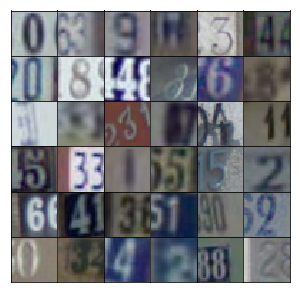

In [5]:
idx = np.random.randint(0, trainset['X'].shape[3], size=36)
fig, axes = plt.subplots(6, 6, sharex=True, sharey=True, figsize=(5,5),)
for ii, ax in zip(idx, axes.flatten()):
    ax.imshow(trainset['X'][:,:,:,ii], aspect='equal')
    ax.xaxis.set_visible(False)
    ax.yaxis.set_visible(False)
plt.subplots_adjust(wspace=0, hspace=0)

Here we need to do a bit of preprocessing and getting the images into a form where we can pass batches to the network. First off, we need to rescale the images to a range of -1 to 1, since the output of our generator is also in that range. We also have a set of test and validation images which could be used if we're trying to identify the numbers in the images.

In [6]:
def scale(x, feature_range=(-1, 1)):
    # scale to (0, 1)
    x = ((x - x.min())/(255 - x.min()))
    
    # scale to feature_range
    min, max = feature_range
    x = x * (max - min) + min
    return x

In [7]:
class Dataset:
    def __init__(self, train, test, val_frac=0.5, shuffle=False, scale_func=None):
        split_idx = int(len(test['y'])*(1 - val_frac))
        self.test_x, self.valid_x = test['X'][:,:,:,:split_idx], test['X'][:,:,:,split_idx:]
        self.test_y, self.valid_y = test['y'][:split_idx], test['y'][split_idx:]
        self.train_x, self.train_y = train['X'], train['y']
        
        self.train_x = np.rollaxis(self.train_x, 3)
        self.valid_x = np.rollaxis(self.valid_x, 3)
        self.test_x = np.rollaxis(self.test_x, 3)
        
        if scale_func is None:
            self.scaler = scale
        else:
            self.scaler = scale_func
        self.shuffle = shuffle
        
    def batches(self, batch_size):
        if self.shuffle:
            idx = np.arange(len(dataset.train_x))
            np.random.shuffle(idx)
            self.train_x = self.train_x[idx]
            self.train_y = self.train_y[idx]
        
        n_batches = len(self.train_y)//batch_size
        for ii in range(0, len(self.train_y), batch_size):
            x = self.train_x[ii:ii+batch_size]
            y = self.train_y[ii:ii+batch_size]
            
            yield self.scaler(x), self.scaler(y)

## Network Inputs

Here, just creating some placeholders like normal.

In [8]:
def model_inputs(real_dim, z_dim):
    inputs_real = tf.placeholder(tf.float32, (None, *real_dim), name='input_real')
    inputs_z = tf.placeholder(tf.float32, (None, z_dim), name='input_z')
    
    return inputs_real, inputs_z

## Generator

Here you'll build the generator network. The input will be our noise vector `z` as before. Also as before, the output will be a $tanh$ output, but this time with size 32x32 which is the size of our SVHN images.

What's new here is we'll use convolutional layers to create our new images. The first layer is a fully connected layer which is reshaped into a deep and narrow layer, something like 4x4x1024 as in the original DCGAN paper. Then we use batch normalization and a leaky ReLU activation. Next is a transposed convolution where typically you'd halve the depth and double the width and height of the previous layer. Again, we use batch normalization and leaky ReLU. For each of these layers, the general scheme is convolution > batch norm > leaky ReLU.

You keep stacking layers up like this until you get the final transposed convolution layer with shape 32x32x3. Below is the archicture used in the original DCGAN paper:

![DCGAN Generator](assets/dcgan.png)

Note that the final layer here is 64x64x3, while for our SVHN dataset, we only want it to be 32x32x3. 

>**Exercise:** Build the transposed convolutional network for the generator in the function below. Be sure to use leaky ReLUs on all the layers except for the last tanh layer, as well as batch normalization on all the transposed convolutional layers except the last one.

In [9]:
def generator(z, output_dim, reuse=False, alpha=0.2, training=True):
    with tf.variable_scope('generator', reuse=reuse):
        # First fully connected layer
        x1 = tf.layers.dense(z, 4*4*512)
        
        # Reshape it to start the convolutional stack
        x1 = tf.reshape(x1, (-1, 4, 4, 512))
        x1 = tf.layers.batch_normalization(x1, training=training)
        x1 = tf.maximum(alpha * x1, x1)
        # 4x4x512 
        x2 = tf.layers.conv2d_transpose(x1, 256, 5, strides=2, padding='same')
        x2 = tf.layers.batch_normalization(x2, training=training)
        x2 = tf.maximum(alpha * x2, x2)
        # 8x8x256 
        x3 = tf.layers.conv2d_transpose(x2, 128, 5, strides=2, padding='same')
        x3 = tf.layers.batch_normalization(x3, training=training)
        x3 = tf.maximum(alpha * x3, x3)
        # 16x16x128 
        
        # Output layer
        logits = tf.layers.conv2d_transpose(x3, output_dim, 5, strides=2, padding='same')
        # 32x32x3 
        out = tf.tanh(logits)
        return out

## Discriminator

Here you'll build the discriminator. This is basically just a convolutional classifier like you've build before. The input to the discriminator are 32x32x3 tensors/images. You'll want a few convolutional layers, then a fully connected layer for the output. As before, we want a sigmoid output, and you'll need to return the logits as well. For the depths of the convolutional layers I suggest starting with 16, 32, 64 filters in the first layer, then double the depth as you add layers. Note that in the DCGAN paper, they did all the downsampling using only strided convolutional layers with no maxpool layers.

You'll also want to use batch normalization with `tf.layers.batch_normalization` on each layer except the first convolutional and output layers. Again, each layer should look something like convolution > batch norm > leaky ReLU.

>**Exercise:** Build the convolutional network for the discriminator. The input is a 32x32x3 images, the output is a sigmoid plus the logits. Again, use Leaky ReLU activations and batch normalization on all the layers except the first.

In [10]:
def discriminator(x, reuse=False, alpha=0.2):
    with tf.variable_scope('discriminator', reuse=reuse):
        # Input layer is 32x32x3
        x1 = tf.layers.conv2d(x, 64, 5, strides=2, padding='same')
        relu1 = tf.maximum(alpha * x1, x1)
        # 16x16x32
        x2 = tf.layers.conv2d(relu1, 128, 5, strides=2, padding='same')
        bn2 = tf.layers.batch_normalization(x2, training=True)
        relu2 = tf.maximum(alpha * bn2, bn2)
        # 8x8x128
        x3 = tf.layers.conv2d(relu2, 256, 5, strides=2, padding='same')
        bn3 = tf.layers.batch_normalization(x3, training=True)
        relu3 = tf.maximum(alpha * bn3, bn3)
        # 4x4x256

        # Flatten it
        flat = tf.reshape(relu3, (-1, 4*4*256))
        logits = tf.layers.dense(flat, 1)
        out = tf.sigmoid(logits)
        
        return out, logits

## Model Loss

Calculating the loss like before, nothing new here.

In [11]:
def model_loss(input_real, input_z, output_dim, alpha=0.2):
    """
    Get the loss for the discriminator and generator
    :param input_real: Images from the real dataset
    :param input_z: Z input
    :param out_channel_dim: The number of channels in the output image
    :return: A tuple of (discriminator loss, generator loss)
    """
    g_model = generator(input_z, output_dim, alpha=alpha)
    d_model_real, d_logits_real = discriminator(input_real, alpha=alpha)
    d_model_fake, d_logits_fake = discriminator(g_model, reuse=True, alpha=alpha)

    d_loss_real = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_real, labels=tf.ones_like(d_model_real)))
    d_loss_fake = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_fake, labels=tf.zeros_like(d_model_fake)))
    g_loss = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_fake, labels=tf.ones_like(d_model_fake)))

    d_loss = d_loss_real + d_loss_fake

    return d_loss, g_loss

## Optimizers

Again, nothing new here.

In [12]:
def model_opt(d_loss, g_loss, learning_rate, beta1):
    """
    Get optimization operations
    :param d_loss: Discriminator loss Tensor
    :param g_loss: Generator loss Tensor
    :param learning_rate: Learning Rate Placeholder
    :param beta1: The exponential decay rate for the 1st moment in the optimizer
    :return: A tuple of (discriminator training operation, generator training operation)
    """
    # Get weights and bias to update
    t_vars = tf.trainable_variables()
    d_vars = [var for var in t_vars if var.name.startswith('discriminator')]
    g_vars = [var for var in t_vars if var.name.startswith('generator')]

    # Optimize
    d_train_opt = tf.train.AdamOptimizer(learning_rate, beta1=beta1).minimize(d_loss, var_list=d_vars)
    g_train_opt = tf.train.AdamOptimizer(learning_rate, beta1=beta1).minimize(g_loss, var_list=g_vars)

    return d_train_opt, g_train_opt

## Building the model

Here we can use the functions we defined about to build the model as a class. This will make it easier to move the network around in our code since the nodes and operations in the graph are packaged in one object.

In [13]:
class GAN:
    def __init__(self, real_size, z_size, learning_rate, alpha=0.2, beta1=0.5):
        tf.reset_default_graph()
        
        self.input_real, self.input_z = model_inputs(real_size, z_size)
        
        self.d_loss, self.g_loss = model_loss(self.input_real, self.input_z,
                                              real_size[2], alpha=0.2)
        
        self.d_opt, self.g_opt = model_opt(self.d_loss, self.g_loss, learning_rate, 0.5)

Here is a function for displaying generated images.

In [14]:
def view_samples(epoch, samples, nrows, ncols, figsize=(5,5)):
    fig, axes = plt.subplots(figsize=figsize, nrows=nrows, ncols=ncols, 
                             sharey=True, sharex=True)
    for ax, img in zip(axes.flatten(), samples[epoch]):
        ax.axis('off')
        img = ((img - img.min())*255 / (img.max() - img.min())).astype(np.uint8)
        ax.set_adjustable('box-forced')
        im = ax.imshow(img)
   
    plt.subplots_adjust(wspace=0, hspace=0)
    return fig, axes

And another function we can use to train our network.

In [15]:
def train(net, dataset, epochs, batch_size, print_every=10, show_every=100, figsize=(5,5)):
    saver = tf.train.Saver()
    sample_z = np.random.uniform(-1, 1, size=(50, z_size))

    samples, losses = [], []
    steps = 0

    with tf.Session() as sess:
        sess.run(tf.global_variables_initializer())
        for e in range(epochs):
            for x, y in dataset.batches(batch_size):
                steps += 1

                # Sample random noise for G
                batch_z = np.random.uniform(-1, 1, size=(batch_size, z_size))

                # Run optimizers
                _ = sess.run(net.d_opt, feed_dict={net.input_real: x, net.input_z: batch_z})
                _ = sess.run(net.g_opt, feed_dict={net.input_z: batch_z})

                if steps % print_every == 0:
                    # At the end of each epoch, get the losses and print them out
                    train_loss_d = net.d_loss.eval({net.input_z: batch_z, net.input_real: x})
                    train_loss_g = net.g_loss.eval({net.input_z: batch_z})

                    print("Epoch {}/{}...".format(e+1, epochs),
                          "Discriminator Loss: {:.4f}...".format(train_loss_d),
                          "Generator Loss: {:.4f}".format(train_loss_g))
                    # Save losses to view after training
                    losses.append((train_loss_d, train_loss_g))

                if steps % show_every == 0:
                    gen_samples = sess.run(
                                   generator(net.input_z, 3, reuse=True),
                                   feed_dict={net.input_z: sample_z})
                    samples.append(gen_samples)
                    _ = view_samples(-1, samples, 5, 10, figsize=figsize)
                    plt.show()

        saver.save(sess, './checkpoints/generator.ckpt')

    with open('samples.pkl', 'wb') as f:
        pkl.dump(samples, f)
    
    return losses, samples

## Hyperparameters

GANs are very senstive to hyperparameters. A lot of experimentation goes into finding the best hyperparameters such that the generator and discriminator don't overpower each other. Try out your own hyperparameters or read [the DCGAN paper](https://arxiv.org/pdf/1511.06434.pdf) to see what worked for them.

>**Exercise:** Find hyperparameters to train this GAN. The values found in the DCGAN paper work well, or you can experiment on your own. In general, you want the discriminator loss to be around 0.3, this means it is correctly classifying images as fake or real about 50% of the time.

In [20]:
real_size = (32,32,3)
z_size = 100
learning_rate = 0.0002
batch_size = 128
epochs = 25
alpha = 0.2
beta1 = 0.5

# Create the network
net = GAN(real_size, z_size, learning_rate, alpha=alpha, beta1=beta1)

Epoch 1/25... Discriminator Loss: 1.3088... Generator Loss: 0.7011
Epoch 1/25... Discriminator Loss: 0.6547... Generator Loss: 1.0288
Epoch 1/25... Discriminator Loss: 0.3413... Generator Loss: 1.6051
Epoch 1/25... Discriminator Loss: 0.1703... Generator Loss: 2.4356
Epoch 1/25... Discriminator Loss: 0.1397... Generator Loss: 2.7774
Epoch 1/25... Discriminator Loss: 0.1204... Generator Loss: 2.6265
Epoch 1/25... Discriminator Loss: 0.0961... Generator Loss: 3.4785
Epoch 1/25... Discriminator Loss: 0.1629... Generator Loss: 2.9034
Epoch 1/25... Discriminator Loss: 0.0966... Generator Loss: 3.4914
Epoch 1/25... Discriminator Loss: 0.1280... Generator Loss: 2.9954


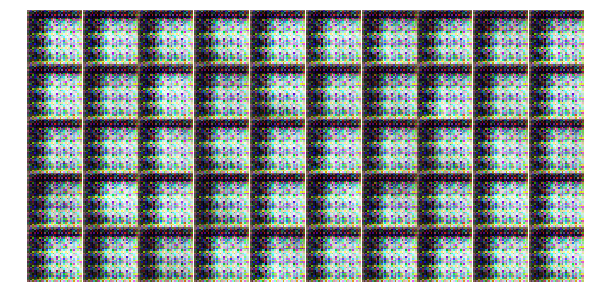

Epoch 1/25... Discriminator Loss: 0.1252... Generator Loss: 3.4856
Epoch 1/25... Discriminator Loss: 0.2626... Generator Loss: 2.9561
Epoch 1/25... Discriminator Loss: 0.5570... Generator Loss: 1.9549
Epoch 1/25... Discriminator Loss: 0.5850... Generator Loss: 1.2061
Epoch 1/25... Discriminator Loss: 0.6330... Generator Loss: 1.2812
Epoch 1/25... Discriminator Loss: 0.4882... Generator Loss: 3.3282
Epoch 1/25... Discriminator Loss: 0.6437... Generator Loss: 2.0083
Epoch 1/25... Discriminator Loss: 0.4645... Generator Loss: 1.4683
Epoch 1/25... Discriminator Loss: 0.8782... Generator Loss: 2.4317
Epoch 1/25... Discriminator Loss: 0.6985... Generator Loss: 0.9242


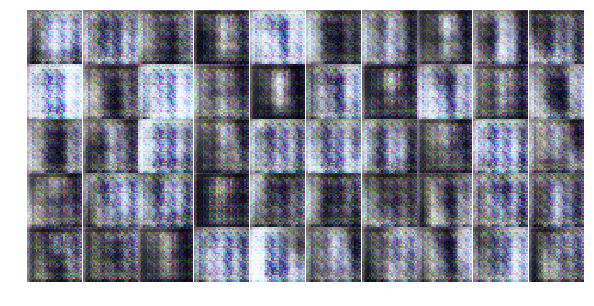

Epoch 1/25... Discriminator Loss: 1.4453... Generator Loss: 0.4594
Epoch 1/25... Discriminator Loss: 0.5439... Generator Loss: 1.2662
Epoch 1/25... Discriminator Loss: 0.4272... Generator Loss: 2.7791
Epoch 1/25... Discriminator Loss: 0.3714... Generator Loss: 1.5637
Epoch 1/25... Discriminator Loss: 0.4991... Generator Loss: 3.2967
Epoch 1/25... Discriminator Loss: 1.6824... Generator Loss: 6.0503
Epoch 1/25... Discriminator Loss: 0.3063... Generator Loss: 1.9290
Epoch 1/25... Discriminator Loss: 0.5267... Generator Loss: 1.2286
Epoch 1/25... Discriminator Loss: 0.3450... Generator Loss: 4.2323
Epoch 1/25... Discriminator Loss: 1.0044... Generator Loss: 0.9052


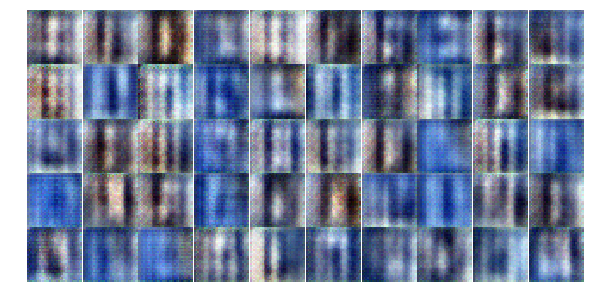

Epoch 1/25... Discriminator Loss: 0.7228... Generator Loss: 1.1347
Epoch 1/25... Discriminator Loss: 0.6444... Generator Loss: 1.6218
Epoch 1/25... Discriminator Loss: 0.8260... Generator Loss: 1.0767
Epoch 1/25... Discriminator Loss: 1.1819... Generator Loss: 0.9805
Epoch 1/25... Discriminator Loss: 0.8632... Generator Loss: 1.0663
Epoch 1/25... Discriminator Loss: 0.6241... Generator Loss: 1.1530
Epoch 1/25... Discriminator Loss: 0.7586... Generator Loss: 0.9622
Epoch 1/25... Discriminator Loss: 0.5197... Generator Loss: 2.1853
Epoch 1/25... Discriminator Loss: 0.7777... Generator Loss: 1.0365
Epoch 1/25... Discriminator Loss: 0.4797... Generator Loss: 2.0188


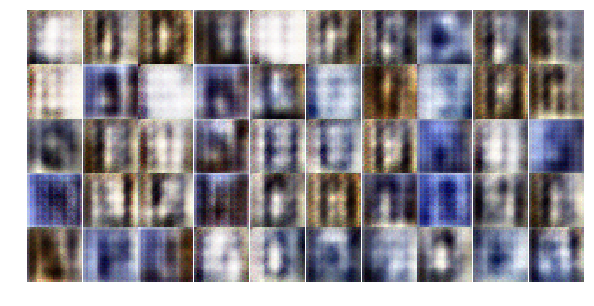

Epoch 1/25... Discriminator Loss: 0.6490... Generator Loss: 1.5017
Epoch 1/25... Discriminator Loss: 0.6457... Generator Loss: 1.4884
Epoch 1/25... Discriminator Loss: 1.1508... Generator Loss: 1.6802
Epoch 1/25... Discriminator Loss: 0.8908... Generator Loss: 2.6325
Epoch 1/25... Discriminator Loss: 0.9122... Generator Loss: 1.0237
Epoch 1/25... Discriminator Loss: 0.9416... Generator Loss: 0.8943
Epoch 1/25... Discriminator Loss: 0.5935... Generator Loss: 1.2766
Epoch 1/25... Discriminator Loss: 0.5915... Generator Loss: 1.7298
Epoch 1/25... Discriminator Loss: 0.6001... Generator Loss: 1.3670
Epoch 1/25... Discriminator Loss: 0.9415... Generator Loss: 1.0428


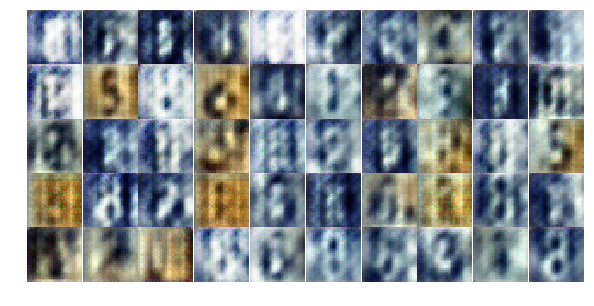

Epoch 1/25... Discriminator Loss: 0.7470... Generator Loss: 1.1316
Epoch 1/25... Discriminator Loss: 0.8614... Generator Loss: 0.9370
Epoch 1/25... Discriminator Loss: 0.6731... Generator Loss: 1.6638
Epoch 1/25... Discriminator Loss: 0.7773... Generator Loss: 1.1308
Epoch 1/25... Discriminator Loss: 0.6192... Generator Loss: 1.9237
Epoch 1/25... Discriminator Loss: 0.6264... Generator Loss: 1.5592
Epoch 1/25... Discriminator Loss: 0.9650... Generator Loss: 1.4363
Epoch 2/25... Discriminator Loss: 0.7072... Generator Loss: 1.8037
Epoch 2/25... Discriminator Loss: 0.6524... Generator Loss: 1.4407
Epoch 2/25... Discriminator Loss: 1.1092... Generator Loss: 0.8026


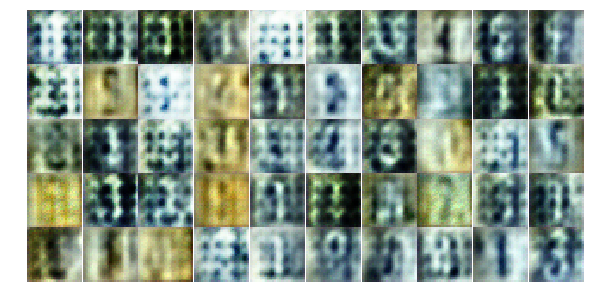

Epoch 2/25... Discriminator Loss: 0.9501... Generator Loss: 1.3068
Epoch 2/25... Discriminator Loss: 1.0856... Generator Loss: 0.7064
Epoch 2/25... Discriminator Loss: 1.2239... Generator Loss: 0.7094
Epoch 2/25... Discriminator Loss: 0.7361... Generator Loss: 1.5350
Epoch 2/25... Discriminator Loss: 1.0691... Generator Loss: 0.8229
Epoch 2/25... Discriminator Loss: 1.0595... Generator Loss: 0.9441
Epoch 2/25... Discriminator Loss: 0.7070... Generator Loss: 1.4232
Epoch 2/25... Discriminator Loss: 0.9228... Generator Loss: 1.1741
Epoch 2/25... Discriminator Loss: 0.8050... Generator Loss: 1.0781
Epoch 2/25... Discriminator Loss: 1.1264... Generator Loss: 1.0236


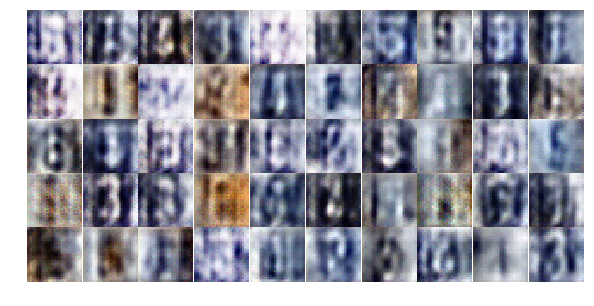

Epoch 2/25... Discriminator Loss: 0.8847... Generator Loss: 1.0194
Epoch 2/25... Discriminator Loss: 1.0936... Generator Loss: 0.9755
Epoch 2/25... Discriminator Loss: 0.7174... Generator Loss: 1.7931
Epoch 2/25... Discriminator Loss: 1.0327... Generator Loss: 1.1115
Epoch 2/25... Discriminator Loss: 1.1013... Generator Loss: 1.0336
Epoch 2/25... Discriminator Loss: 1.5545... Generator Loss: 0.7649
Epoch 2/25... Discriminator Loss: 1.1093... Generator Loss: 0.7299
Epoch 2/25... Discriminator Loss: 1.0399... Generator Loss: 0.9514
Epoch 2/25... Discriminator Loss: 1.2374... Generator Loss: 0.9995
Epoch 2/25... Discriminator Loss: 1.3697... Generator Loss: 0.5232


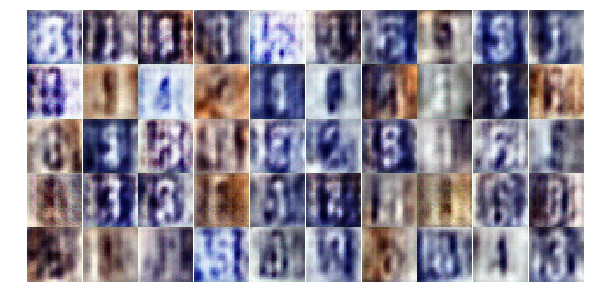

Epoch 2/25... Discriminator Loss: 1.1172... Generator Loss: 0.8225
Epoch 2/25... Discriminator Loss: 0.7401... Generator Loss: 1.2427
Epoch 2/25... Discriminator Loss: 1.0219... Generator Loss: 1.1208
Epoch 2/25... Discriminator Loss: 1.0004... Generator Loss: 1.1370
Epoch 2/25... Discriminator Loss: 1.0917... Generator Loss: 1.1432
Epoch 2/25... Discriminator Loss: 1.0553... Generator Loss: 1.1511
Epoch 2/25... Discriminator Loss: 1.0772... Generator Loss: 0.7136
Epoch 2/25... Discriminator Loss: 1.0404... Generator Loss: 0.8329
Epoch 2/25... Discriminator Loss: 0.9699... Generator Loss: 1.0458
Epoch 2/25... Discriminator Loss: 1.0394... Generator Loss: 1.0179


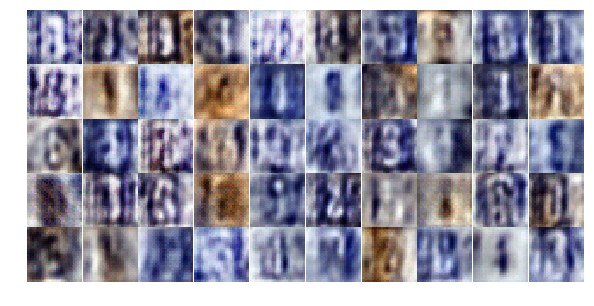

Epoch 2/25... Discriminator Loss: 1.0266... Generator Loss: 1.1465
Epoch 2/25... Discriminator Loss: 0.9281... Generator Loss: 1.2166
Epoch 2/25... Discriminator Loss: 1.0983... Generator Loss: 0.7981
Epoch 2/25... Discriminator Loss: 1.0108... Generator Loss: 0.8811
Epoch 2/25... Discriminator Loss: 0.9833... Generator Loss: 1.4740
Epoch 2/25... Discriminator Loss: 1.3744... Generator Loss: 0.7351
Epoch 2/25... Discriminator Loss: 1.3397... Generator Loss: 0.6635
Epoch 2/25... Discriminator Loss: 0.9992... Generator Loss: 1.2418
Epoch 2/25... Discriminator Loss: 0.9623... Generator Loss: 0.9617
Epoch 2/25... Discriminator Loss: 0.7596... Generator Loss: 1.2001


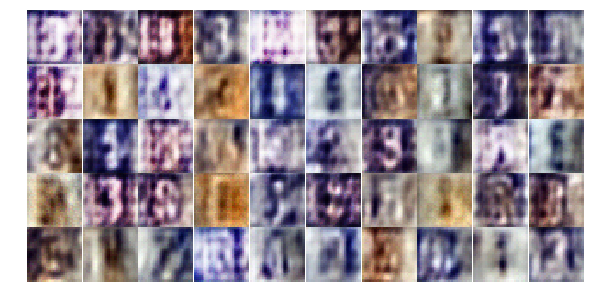

Epoch 2/25... Discriminator Loss: 0.8749... Generator Loss: 1.1940
Epoch 2/25... Discriminator Loss: 1.1689... Generator Loss: 0.8350
Epoch 2/25... Discriminator Loss: 0.7827... Generator Loss: 1.1681
Epoch 2/25... Discriminator Loss: 0.9113... Generator Loss: 0.8601
Epoch 2/25... Discriminator Loss: 0.9989... Generator Loss: 0.9341
Epoch 2/25... Discriminator Loss: 0.9128... Generator Loss: 0.9091
Epoch 2/25... Discriminator Loss: 0.6702... Generator Loss: 1.4638
Epoch 2/25... Discriminator Loss: 1.4943... Generator Loss: 3.4901
Epoch 2/25... Discriminator Loss: 0.7793... Generator Loss: 1.0882
Epoch 2/25... Discriminator Loss: 0.8253... Generator Loss: 0.9828


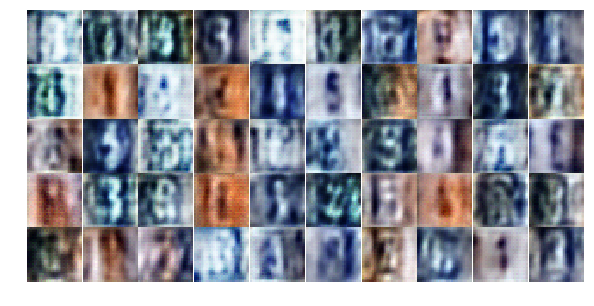

Epoch 2/25... Discriminator Loss: 0.6867... Generator Loss: 1.2973
Epoch 2/25... Discriminator Loss: 0.9386... Generator Loss: 0.7175
Epoch 2/25... Discriminator Loss: 1.2086... Generator Loss: 0.6719
Epoch 2/25... Discriminator Loss: 0.9754... Generator Loss: 0.8547
Epoch 3/25... Discriminator Loss: 0.8937... Generator Loss: 1.4252
Epoch 3/25... Discriminator Loss: 0.8609... Generator Loss: 1.0721
Epoch 3/25... Discriminator Loss: 0.6263... Generator Loss: 1.5493
Epoch 3/25... Discriminator Loss: 0.7222... Generator Loss: 0.9319
Epoch 3/25... Discriminator Loss: 0.7791... Generator Loss: 0.8947
Epoch 3/25... Discriminator Loss: 0.6758... Generator Loss: 1.3636


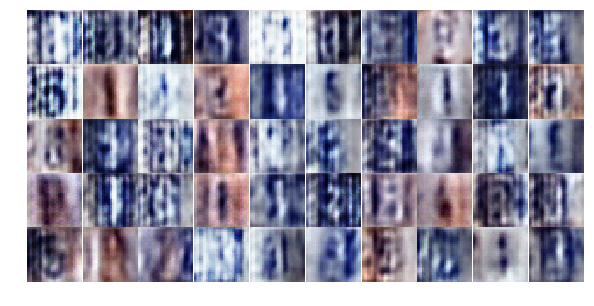

Epoch 3/25... Discriminator Loss: 0.4957... Generator Loss: 1.9569
Epoch 3/25... Discriminator Loss: 0.6173... Generator Loss: 2.0571
Epoch 3/25... Discriminator Loss: 0.7250... Generator Loss: 2.0451
Epoch 3/25... Discriminator Loss: 1.0112... Generator Loss: 2.3662
Epoch 3/25... Discriminator Loss: 0.7465... Generator Loss: 1.7212
Epoch 3/25... Discriminator Loss: 0.9876... Generator Loss: 0.7890
Epoch 3/25... Discriminator Loss: 0.9014... Generator Loss: 0.8756
Epoch 3/25... Discriminator Loss: 0.3382... Generator Loss: 2.0691
Epoch 3/25... Discriminator Loss: 0.5573... Generator Loss: 1.1550
Epoch 3/25... Discriminator Loss: 0.7550... Generator Loss: 1.0832


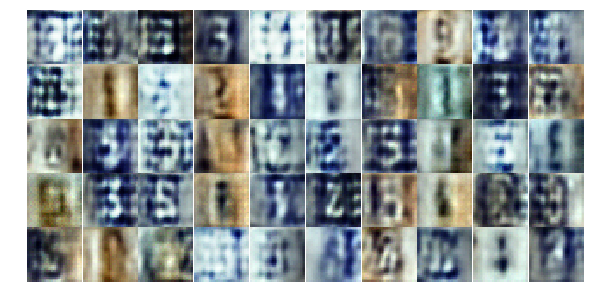

Epoch 3/25... Discriminator Loss: 0.7633... Generator Loss: 2.1339
Epoch 3/25... Discriminator Loss: 0.7010... Generator Loss: 1.1542
Epoch 3/25... Discriminator Loss: 1.1167... Generator Loss: 1.7757
Epoch 3/25... Discriminator Loss: 0.7451... Generator Loss: 1.0092
Epoch 3/25... Discriminator Loss: 1.1382... Generator Loss: 2.9862
Epoch 3/25... Discriminator Loss: 1.0135... Generator Loss: 1.6915
Epoch 3/25... Discriminator Loss: 0.7029... Generator Loss: 2.4039
Epoch 3/25... Discriminator Loss: 0.5277... Generator Loss: 1.7903
Epoch 3/25... Discriminator Loss: 0.4963... Generator Loss: 1.3958
Epoch 3/25... Discriminator Loss: 0.8031... Generator Loss: 0.9181


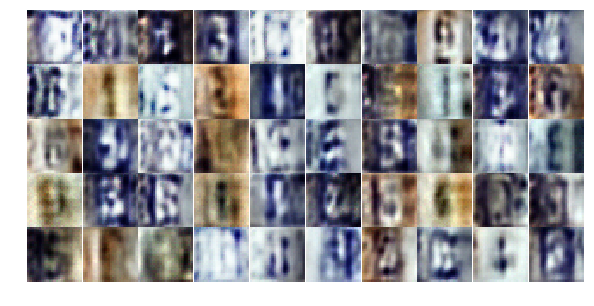

Epoch 3/25... Discriminator Loss: 0.7683... Generator Loss: 2.6975
Epoch 3/25... Discriminator Loss: 0.7445... Generator Loss: 1.3952
Epoch 3/25... Discriminator Loss: 0.7752... Generator Loss: 1.2119
Epoch 3/25... Discriminator Loss: 0.6167... Generator Loss: 1.8568
Epoch 3/25... Discriminator Loss: 0.6389... Generator Loss: 1.0590
Epoch 3/25... Discriminator Loss: 0.6520... Generator Loss: 1.3801
Epoch 3/25... Discriminator Loss: 0.6788... Generator Loss: 1.3148
Epoch 3/25... Discriminator Loss: 0.4706... Generator Loss: 2.2453
Epoch 3/25... Discriminator Loss: 0.6154... Generator Loss: 1.1518
Epoch 3/25... Discriminator Loss: 0.5224... Generator Loss: 1.8480


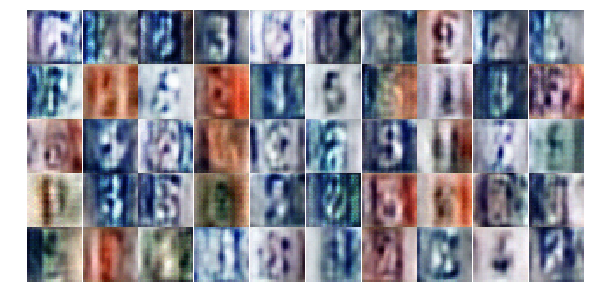

Epoch 3/25... Discriminator Loss: 0.2459... Generator Loss: 2.3744
Epoch 3/25... Discriminator Loss: 0.3628... Generator Loss: 1.8718
Epoch 3/25... Discriminator Loss: 0.5966... Generator Loss: 1.0990
Epoch 3/25... Discriminator Loss: 0.3384... Generator Loss: 1.8911
Epoch 3/25... Discriminator Loss: 0.2832... Generator Loss: 2.2939
Epoch 3/25... Discriminator Loss: 0.8140... Generator Loss: 0.8102
Epoch 3/25... Discriminator Loss: 1.1456... Generator Loss: 0.7870
Epoch 3/25... Discriminator Loss: 0.6902... Generator Loss: 1.2110
Epoch 3/25... Discriminator Loss: 0.3942... Generator Loss: 1.9690
Epoch 3/25... Discriminator Loss: 0.5983... Generator Loss: 2.9665


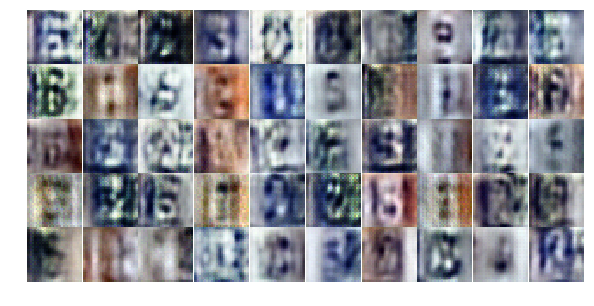

Epoch 3/25... Discriminator Loss: 0.5174... Generator Loss: 1.5721
Epoch 3/25... Discriminator Loss: 0.7256... Generator Loss: 2.8049
Epoch 3/25... Discriminator Loss: 0.5868... Generator Loss: 1.3669
Epoch 3/25... Discriminator Loss: 0.3283... Generator Loss: 2.2334
Epoch 3/25... Discriminator Loss: 0.8426... Generator Loss: 0.7970
Epoch 3/25... Discriminator Loss: 0.4329... Generator Loss: 1.8411
Epoch 3/25... Discriminator Loss: 0.5401... Generator Loss: 2.0918
Epoch 3/25... Discriminator Loss: 0.5989... Generator Loss: 1.7732
Epoch 3/25... Discriminator Loss: 0.4607... Generator Loss: 1.9286
Epoch 3/25... Discriminator Loss: 0.5663... Generator Loss: 1.7852


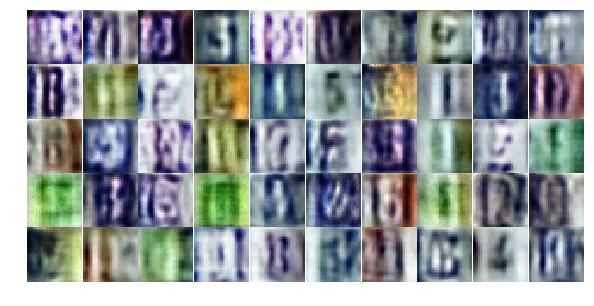

Epoch 3/25... Discriminator Loss: 0.4485... Generator Loss: 1.7727
Epoch 4/25... Discriminator Loss: 0.5667... Generator Loss: 2.1589
Epoch 4/25... Discriminator Loss: 0.4734... Generator Loss: 1.9785
Epoch 4/25... Discriminator Loss: 1.5292... Generator Loss: 0.3597
Epoch 4/25... Discriminator Loss: 0.5124... Generator Loss: 2.1171
Epoch 4/25... Discriminator Loss: 0.6013... Generator Loss: 1.3761
Epoch 4/25... Discriminator Loss: 0.5488... Generator Loss: 1.4719
Epoch 4/25... Discriminator Loss: 0.5477... Generator Loss: 2.4833
Epoch 4/25... Discriminator Loss: 0.8023... Generator Loss: 2.0832
Epoch 4/25... Discriminator Loss: 0.6881... Generator Loss: 1.2522


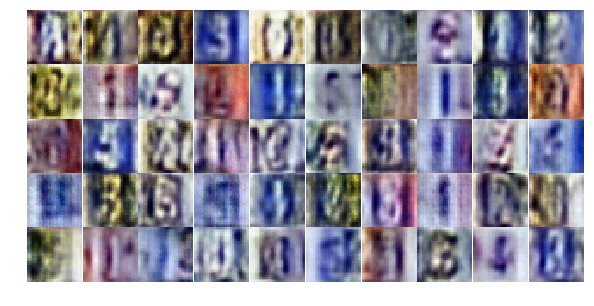

Epoch 4/25... Discriminator Loss: 0.7350... Generator Loss: 1.3082
Epoch 4/25... Discriminator Loss: 0.3977... Generator Loss: 1.9669
Epoch 4/25... Discriminator Loss: 0.8009... Generator Loss: 1.0915
Epoch 4/25... Discriminator Loss: 0.6632... Generator Loss: 1.3587
Epoch 4/25... Discriminator Loss: 0.4910... Generator Loss: 1.3835
Epoch 4/25... Discriminator Loss: 1.1516... Generator Loss: 0.5572
Epoch 4/25... Discriminator Loss: 1.0712... Generator Loss: 0.6261
Epoch 4/25... Discriminator Loss: 0.4703... Generator Loss: 1.4141
Epoch 4/25... Discriminator Loss: 1.0824... Generator Loss: 2.8574
Epoch 4/25... Discriminator Loss: 0.8176... Generator Loss: 2.1450


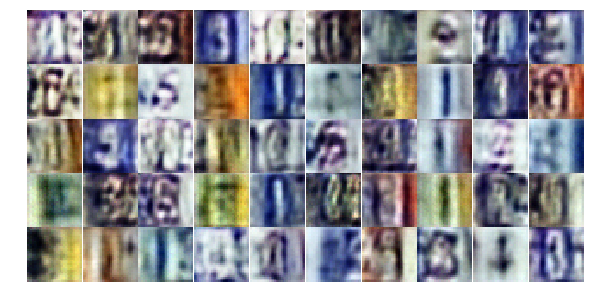

Epoch 4/25... Discriminator Loss: 0.4444... Generator Loss: 1.5445
Epoch 4/25... Discriminator Loss: 0.8202... Generator Loss: 0.7951
Epoch 4/25... Discriminator Loss: 0.7557... Generator Loss: 0.8315
Epoch 4/25... Discriminator Loss: 0.6048... Generator Loss: 1.1572
Epoch 4/25... Discriminator Loss: 0.3050... Generator Loss: 2.3294
Epoch 4/25... Discriminator Loss: 0.4713... Generator Loss: 2.0990
Epoch 4/25... Discriminator Loss: 0.2831... Generator Loss: 2.1431
Epoch 4/25... Discriminator Loss: 0.3582... Generator Loss: 2.4847
Epoch 4/25... Discriminator Loss: 0.6667... Generator Loss: 1.4105
Epoch 4/25... Discriminator Loss: 0.5767... Generator Loss: 2.0356


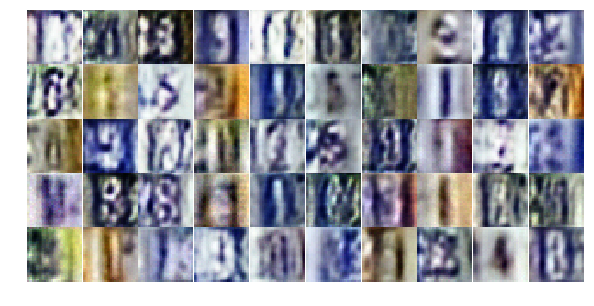

Epoch 4/25... Discriminator Loss: 0.4160... Generator Loss: 2.4141
Epoch 4/25... Discriminator Loss: 0.4791... Generator Loss: 2.0157
Epoch 4/25... Discriminator Loss: 0.2651... Generator Loss: 2.3053
Epoch 4/25... Discriminator Loss: 0.3690... Generator Loss: 2.3354
Epoch 4/25... Discriminator Loss: 1.0746... Generator Loss: 0.5828
Epoch 4/25... Discriminator Loss: 0.9142... Generator Loss: 2.2116
Epoch 4/25... Discriminator Loss: 0.3822... Generator Loss: 2.0845
Epoch 4/25... Discriminator Loss: 0.8466... Generator Loss: 0.7361
Epoch 4/25... Discriminator Loss: 1.0163... Generator Loss: 0.5962
Epoch 4/25... Discriminator Loss: 0.7344... Generator Loss: 0.9191


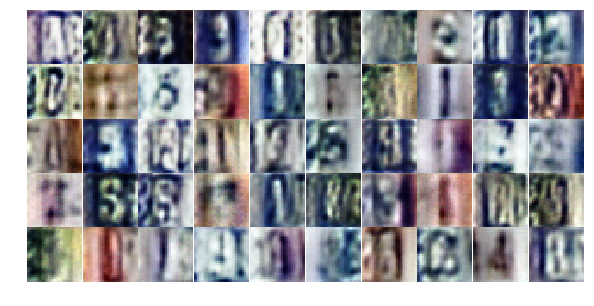

Epoch 4/25... Discriminator Loss: 0.4909... Generator Loss: 1.5431
Epoch 4/25... Discriminator Loss: 0.2611... Generator Loss: 2.2351
Epoch 4/25... Discriminator Loss: 0.3664... Generator Loss: 2.9724
Epoch 4/25... Discriminator Loss: 0.6446... Generator Loss: 1.1904
Epoch 4/25... Discriminator Loss: 0.5615... Generator Loss: 1.3022
Epoch 4/25... Discriminator Loss: 1.3865... Generator Loss: 2.5065
Epoch 4/25... Discriminator Loss: 0.6498... Generator Loss: 2.3920
Epoch 4/25... Discriminator Loss: 0.4881... Generator Loss: 1.8786
Epoch 4/25... Discriminator Loss: 0.6428... Generator Loss: 0.9944
Epoch 4/25... Discriminator Loss: 0.6202... Generator Loss: 2.4792


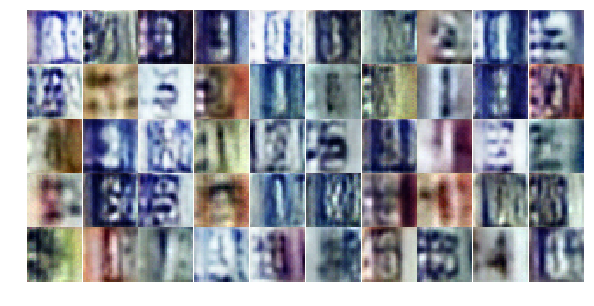

Epoch 4/25... Discriminator Loss: 0.7226... Generator Loss: 2.9259
Epoch 4/25... Discriminator Loss: 0.6298... Generator Loss: 2.3833
Epoch 4/25... Discriminator Loss: 0.3839... Generator Loss: 2.0293
Epoch 4/25... Discriminator Loss: 0.5922... Generator Loss: 2.1886
Epoch 4/25... Discriminator Loss: 0.4589... Generator Loss: 1.6579
Epoch 4/25... Discriminator Loss: 0.5262... Generator Loss: 1.6556
Epoch 4/25... Discriminator Loss: 0.4755... Generator Loss: 1.6985
Epoch 4/25... Discriminator Loss: 0.2370... Generator Loss: 2.3895
Epoch 4/25... Discriminator Loss: 0.4066... Generator Loss: 1.6456
Epoch 5/25... Discriminator Loss: 0.5057... Generator Loss: 2.2498


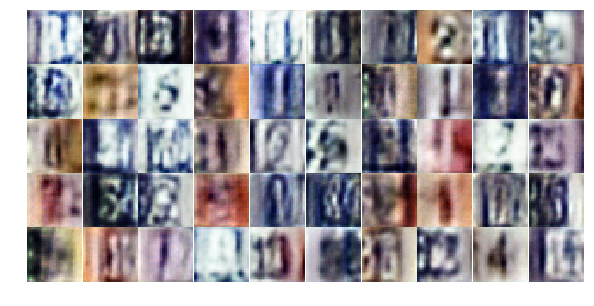

Epoch 5/25... Discriminator Loss: 0.2819... Generator Loss: 2.3691
Epoch 5/25... Discriminator Loss: 1.4747... Generator Loss: 3.8024
Epoch 5/25... Discriminator Loss: 0.4001... Generator Loss: 1.9207
Epoch 5/25... Discriminator Loss: 0.4459... Generator Loss: 1.5041
Epoch 5/25... Discriminator Loss: 0.6185... Generator Loss: 3.0051
Epoch 5/25... Discriminator Loss: 0.9492... Generator Loss: 0.6890
Epoch 5/25... Discriminator Loss: 0.3744... Generator Loss: 1.6486
Epoch 5/25... Discriminator Loss: 0.2393... Generator Loss: 2.2563
Epoch 5/25... Discriminator Loss: 0.7770... Generator Loss: 3.0465
Epoch 5/25... Discriminator Loss: 0.5695... Generator Loss: 1.3080


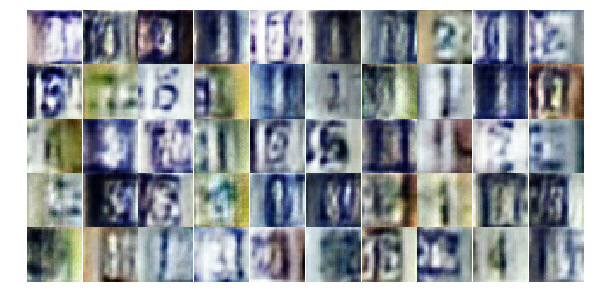

Epoch 5/25... Discriminator Loss: 2.1895... Generator Loss: 3.9777
Epoch 5/25... Discriminator Loss: 0.4573... Generator Loss: 1.5370
Epoch 5/25... Discriminator Loss: 0.6501... Generator Loss: 1.0826
Epoch 5/25... Discriminator Loss: 0.6765... Generator Loss: 1.0006
Epoch 5/25... Discriminator Loss: 0.6111... Generator Loss: 1.8409
Epoch 5/25... Discriminator Loss: 0.4314... Generator Loss: 1.7436
Epoch 5/25... Discriminator Loss: 0.5058... Generator Loss: 1.3737
Epoch 5/25... Discriminator Loss: 0.4305... Generator Loss: 1.7197
Epoch 5/25... Discriminator Loss: 0.3442... Generator Loss: 2.0906
Epoch 5/25... Discriminator Loss: 0.4039... Generator Loss: 1.8366


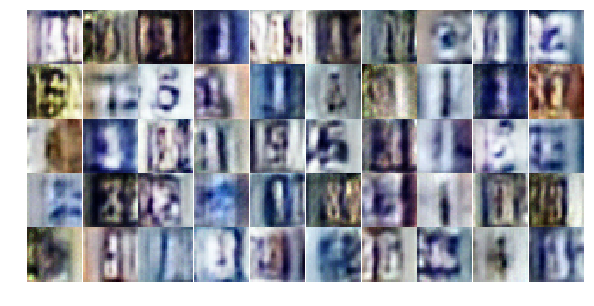

Epoch 5/25... Discriminator Loss: 0.5545... Generator Loss: 2.0979
Epoch 5/25... Discriminator Loss: 0.4509... Generator Loss: 1.8125
Epoch 5/25... Discriminator Loss: 0.6341... Generator Loss: 1.0104
Epoch 5/25... Discriminator Loss: 0.4204... Generator Loss: 1.6560
Epoch 5/25... Discriminator Loss: 0.8607... Generator Loss: 0.7172
Epoch 5/25... Discriminator Loss: 0.8221... Generator Loss: 0.8498
Epoch 5/25... Discriminator Loss: 0.6151... Generator Loss: 0.9908
Epoch 5/25... Discriminator Loss: 0.4453... Generator Loss: 1.5592
Epoch 5/25... Discriminator Loss: 0.9616... Generator Loss: 0.7877
Epoch 5/25... Discriminator Loss: 0.3006... Generator Loss: 1.9163


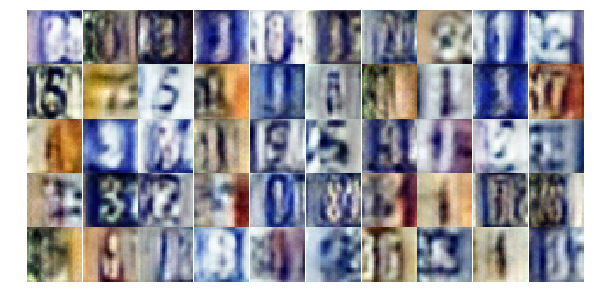

Epoch 5/25... Discriminator Loss: 0.4900... Generator Loss: 2.0359
Epoch 5/25... Discriminator Loss: 0.3970... Generator Loss: 2.4844
Epoch 5/25... Discriminator Loss: 0.4771... Generator Loss: 1.3075
Epoch 5/25... Discriminator Loss: 2.4593... Generator Loss: 5.5386
Epoch 5/25... Discriminator Loss: 0.5593... Generator Loss: 1.4691
Epoch 5/25... Discriminator Loss: 0.3855... Generator Loss: 2.3661
Epoch 5/25... Discriminator Loss: 0.6457... Generator Loss: 1.0680
Epoch 5/25... Discriminator Loss: 0.5855... Generator Loss: 1.1766
Epoch 5/25... Discriminator Loss: 0.3986... Generator Loss: 1.6269
Epoch 5/25... Discriminator Loss: 0.5233... Generator Loss: 1.3213


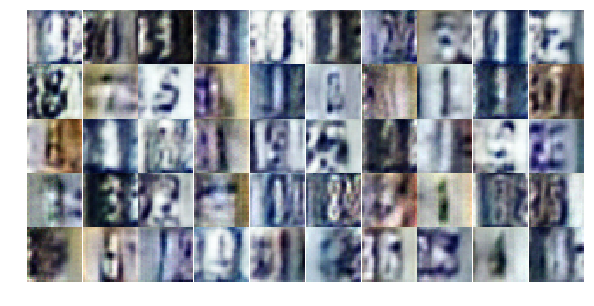

Epoch 5/25... Discriminator Loss: 0.2874... Generator Loss: 2.1189
Epoch 5/25... Discriminator Loss: 0.5605... Generator Loss: 1.0990
Epoch 5/25... Discriminator Loss: 1.0852... Generator Loss: 0.5977
Epoch 5/25... Discriminator Loss: 0.7816... Generator Loss: 2.6284
Epoch 5/25... Discriminator Loss: 0.8950... Generator Loss: 1.4181
Epoch 5/25... Discriminator Loss: 0.6738... Generator Loss: 1.0974
Epoch 5/25... Discriminator Loss: 0.4288... Generator Loss: 1.6167
Epoch 5/25... Discriminator Loss: 0.3605... Generator Loss: 1.6233
Epoch 5/25... Discriminator Loss: 0.3642... Generator Loss: 1.8680
Epoch 5/25... Discriminator Loss: 0.3431... Generator Loss: 1.8714


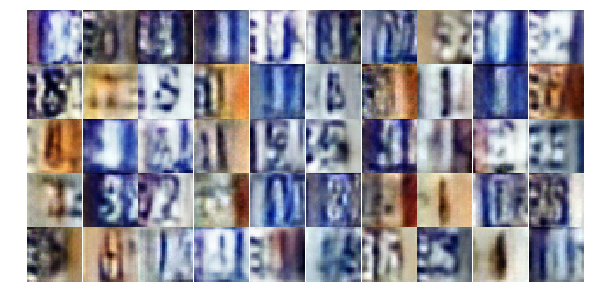

Epoch 5/25... Discriminator Loss: 0.3412... Generator Loss: 1.9186
Epoch 5/25... Discriminator Loss: 1.1177... Generator Loss: 0.7848
Epoch 5/25... Discriminator Loss: 0.7003... Generator Loss: 1.7063
Epoch 5/25... Discriminator Loss: 1.1532... Generator Loss: 0.5465
Epoch 5/25... Discriminator Loss: 1.2062... Generator Loss: 0.5290
Epoch 5/25... Discriminator Loss: 1.1292... Generator Loss: 0.5666
Epoch 6/25... Discriminator Loss: 0.6064... Generator Loss: 1.1732
Epoch 6/25... Discriminator Loss: 0.3802... Generator Loss: 1.5856
Epoch 6/25... Discriminator Loss: 0.4296... Generator Loss: 1.8797
Epoch 6/25... Discriminator Loss: 0.6256... Generator Loss: 1.1381


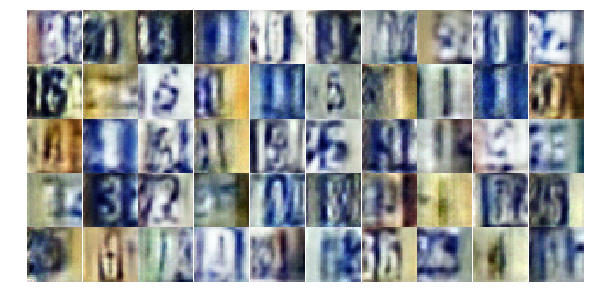

Epoch 6/25... Discriminator Loss: 0.4949... Generator Loss: 1.3806
Epoch 6/25... Discriminator Loss: 0.5202... Generator Loss: 1.4090
Epoch 6/25... Discriminator Loss: 0.3393... Generator Loss: 1.7134
Epoch 6/25... Discriminator Loss: 1.6652... Generator Loss: 0.3049
Epoch 6/25... Discriminator Loss: 1.3340... Generator Loss: 0.5719
Epoch 6/25... Discriminator Loss: 0.6040... Generator Loss: 1.1833
Epoch 6/25... Discriminator Loss: 0.5483... Generator Loss: 1.3463
Epoch 6/25... Discriminator Loss: 0.9021... Generator Loss: 0.7377
Epoch 6/25... Discriminator Loss: 0.7828... Generator Loss: 0.8341
Epoch 6/25... Discriminator Loss: 0.4633... Generator Loss: 1.8192


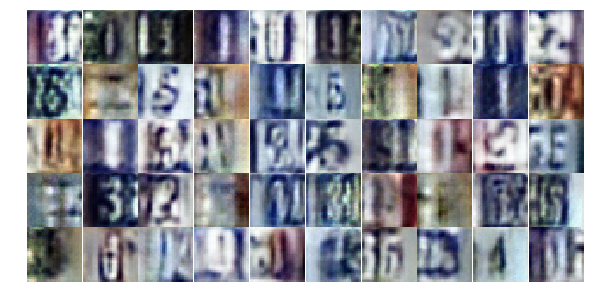

Epoch 6/25... Discriminator Loss: 0.5309... Generator Loss: 1.3949
Epoch 6/25... Discriminator Loss: 0.7090... Generator Loss: 1.0524
Epoch 6/25... Discriminator Loss: 0.9507... Generator Loss: 0.6174
Epoch 6/25... Discriminator Loss: 0.7129... Generator Loss: 0.8596
Epoch 6/25... Discriminator Loss: 0.4831... Generator Loss: 1.2436
Epoch 6/25... Discriminator Loss: 0.4431... Generator Loss: 1.6689
Epoch 6/25... Discriminator Loss: 0.4286... Generator Loss: 1.5445
Epoch 6/25... Discriminator Loss: 0.8454... Generator Loss: 0.8670
Epoch 6/25... Discriminator Loss: 0.7339... Generator Loss: 2.7981
Epoch 6/25... Discriminator Loss: 0.9327... Generator Loss: 0.7632


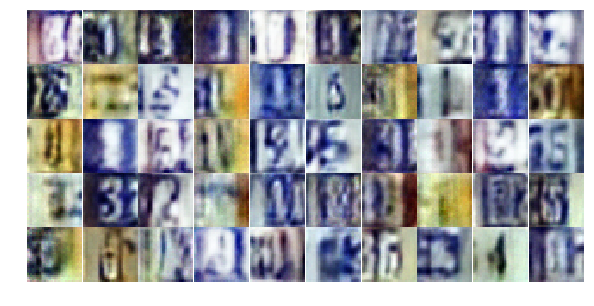

Epoch 6/25... Discriminator Loss: 0.8849... Generator Loss: 0.7019
Epoch 6/25... Discriminator Loss: 0.5337... Generator Loss: 1.2812
Epoch 6/25... Discriminator Loss: 0.6139... Generator Loss: 1.3724
Epoch 6/25... Discriminator Loss: 0.6623... Generator Loss: 0.9824
Epoch 6/25... Discriminator Loss: 0.4811... Generator Loss: 1.2885
Epoch 6/25... Discriminator Loss: 1.3622... Generator Loss: 0.4790
Epoch 6/25... Discriminator Loss: 0.5206... Generator Loss: 1.4924
Epoch 6/25... Discriminator Loss: 0.3372... Generator Loss: 2.4437
Epoch 6/25... Discriminator Loss: 0.5706... Generator Loss: 1.3739
Epoch 6/25... Discriminator Loss: 0.4633... Generator Loss: 1.9093


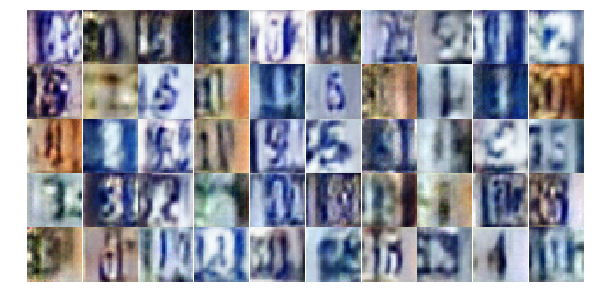

Epoch 6/25... Discriminator Loss: 1.5115... Generator Loss: 0.3433
Epoch 6/25... Discriminator Loss: 0.8396... Generator Loss: 3.0133
Epoch 6/25... Discriminator Loss: 0.5061... Generator Loss: 1.4447
Epoch 6/25... Discriminator Loss: 0.5414... Generator Loss: 1.2988
Epoch 6/25... Discriminator Loss: 0.7057... Generator Loss: 1.4731
Epoch 6/25... Discriminator Loss: 1.1800... Generator Loss: 0.4850
Epoch 6/25... Discriminator Loss: 0.5168... Generator Loss: 3.1491
Epoch 6/25... Discriminator Loss: 0.5428... Generator Loss: 1.4617
Epoch 6/25... Discriminator Loss: 0.6864... Generator Loss: 0.9871
Epoch 6/25... Discriminator Loss: 0.4650... Generator Loss: 1.5118


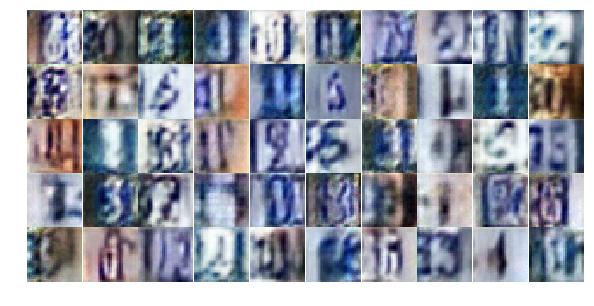

Epoch 6/25... Discriminator Loss: 0.5839... Generator Loss: 1.9947
Epoch 6/25... Discriminator Loss: 0.8338... Generator Loss: 0.8860
Epoch 6/25... Discriminator Loss: 0.9749... Generator Loss: 0.6481
Epoch 6/25... Discriminator Loss: 0.5401... Generator Loss: 1.2710
Epoch 6/25... Discriminator Loss: 0.4188... Generator Loss: 1.9853
Epoch 6/25... Discriminator Loss: 0.4088... Generator Loss: 1.6962
Epoch 6/25... Discriminator Loss: 0.6665... Generator Loss: 0.9564
Epoch 6/25... Discriminator Loss: 0.6232... Generator Loss: 1.0657
Epoch 6/25... Discriminator Loss: 1.2421... Generator Loss: 0.4807
Epoch 6/25... Discriminator Loss: 2.1330... Generator Loss: 0.1800


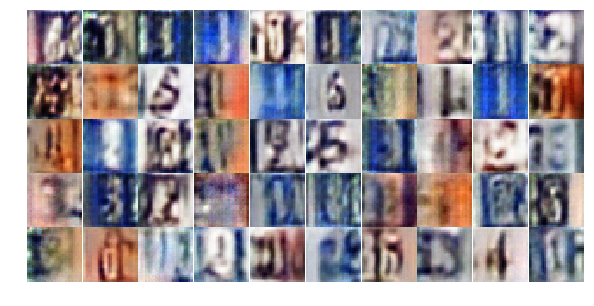

Epoch 6/25... Discriminator Loss: 1.0582... Generator Loss: 2.1299
Epoch 6/25... Discriminator Loss: 0.8164... Generator Loss: 0.7880
Epoch 6/25... Discriminator Loss: 0.6932... Generator Loss: 1.0717
Epoch 7/25... Discriminator Loss: 0.6653... Generator Loss: 1.7598
Epoch 7/25... Discriminator Loss: 0.7849... Generator Loss: 0.9120
Epoch 7/25... Discriminator Loss: 0.3797... Generator Loss: 1.7286
Epoch 7/25... Discriminator Loss: 0.6119... Generator Loss: 1.0304
Epoch 7/25... Discriminator Loss: 0.3704... Generator Loss: 1.7996
Epoch 7/25... Discriminator Loss: 0.6702... Generator Loss: 1.0332
Epoch 7/25... Discriminator Loss: 1.6112... Generator Loss: 1.8028


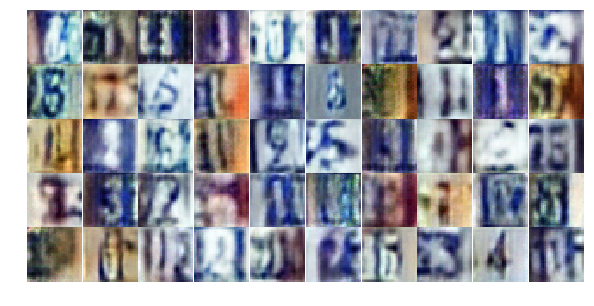

Epoch 7/25... Discriminator Loss: 1.0843... Generator Loss: 1.4170
Epoch 7/25... Discriminator Loss: 1.1757... Generator Loss: 0.6420
Epoch 7/25... Discriminator Loss: 0.6189... Generator Loss: 1.1815
Epoch 7/25... Discriminator Loss: 0.6390... Generator Loss: 1.1801
Epoch 7/25... Discriminator Loss: 0.5739... Generator Loss: 1.3264
Epoch 7/25... Discriminator Loss: 0.5112... Generator Loss: 1.3315
Epoch 7/25... Discriminator Loss: 0.7492... Generator Loss: 2.4459
Epoch 7/25... Discriminator Loss: 0.7449... Generator Loss: 1.9540
Epoch 7/25... Discriminator Loss: 0.6837... Generator Loss: 2.7381
Epoch 7/25... Discriminator Loss: 0.5422... Generator Loss: 1.3451


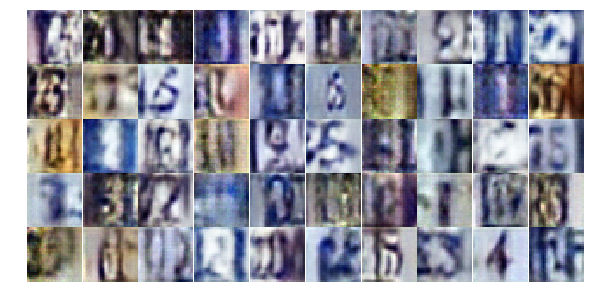

Epoch 7/25... Discriminator Loss: 0.7425... Generator Loss: 0.8668
Epoch 7/25... Discriminator Loss: 0.4505... Generator Loss: 1.5810
Epoch 7/25... Discriminator Loss: 0.8225... Generator Loss: 0.8084
Epoch 7/25... Discriminator Loss: 0.5942... Generator Loss: 1.3871
Epoch 7/25... Discriminator Loss: 0.4211... Generator Loss: 1.4885
Epoch 7/25... Discriminator Loss: 0.4264... Generator Loss: 1.5116
Epoch 7/25... Discriminator Loss: 0.5898... Generator Loss: 1.1614
Epoch 7/25... Discriminator Loss: 1.2103... Generator Loss: 0.5059
Epoch 7/25... Discriminator Loss: 0.4770... Generator Loss: 1.9249
Epoch 7/25... Discriminator Loss: 0.5019... Generator Loss: 1.4693


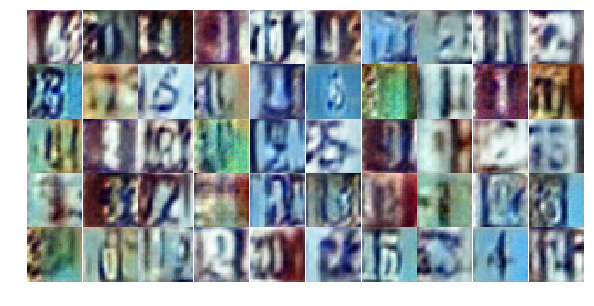

Epoch 7/25... Discriminator Loss: 0.8050... Generator Loss: 0.8307
Epoch 7/25... Discriminator Loss: 1.4759... Generator Loss: 0.3435
Epoch 7/25... Discriminator Loss: 0.4465... Generator Loss: 1.4326
Epoch 7/25... Discriminator Loss: 0.4218... Generator Loss: 1.6873
Epoch 7/25... Discriminator Loss: 0.5800... Generator Loss: 1.1895
Epoch 7/25... Discriminator Loss: 0.9284... Generator Loss: 0.7201
Epoch 7/25... Discriminator Loss: 0.5907... Generator Loss: 1.0643
Epoch 7/25... Discriminator Loss: 0.9099... Generator Loss: 0.7813
Epoch 7/25... Discriminator Loss: 0.8089... Generator Loss: 0.8802
Epoch 7/25... Discriminator Loss: 0.3557... Generator Loss: 2.1821


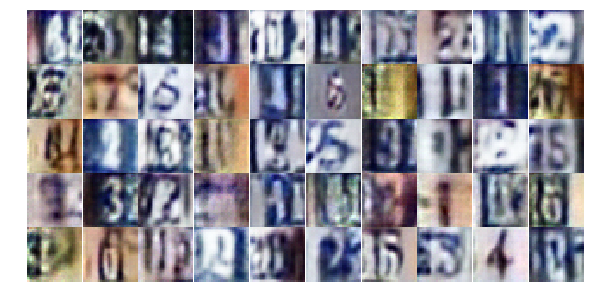

Epoch 7/25... Discriminator Loss: 0.7660... Generator Loss: 1.0322
Epoch 7/25... Discriminator Loss: 0.6431... Generator Loss: 1.1892
Epoch 7/25... Discriminator Loss: 0.3872... Generator Loss: 1.7422
Epoch 7/25... Discriminator Loss: 0.6201... Generator Loss: 1.0719
Epoch 7/25... Discriminator Loss: 0.5054... Generator Loss: 1.9534
Epoch 7/25... Discriminator Loss: 0.4635... Generator Loss: 1.7694
Epoch 7/25... Discriminator Loss: 0.5168... Generator Loss: 1.2866
Epoch 7/25... Discriminator Loss: 0.7977... Generator Loss: 0.8136
Epoch 7/25... Discriminator Loss: 0.4810... Generator Loss: 1.8663
Epoch 7/25... Discriminator Loss: 1.4025... Generator Loss: 0.4211


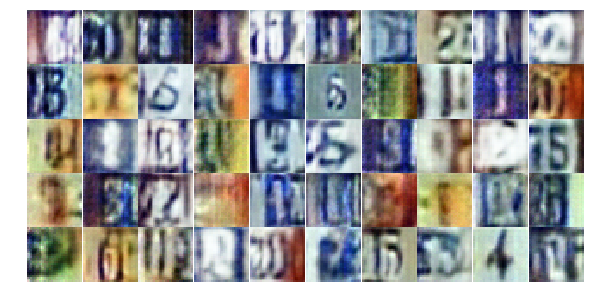

Epoch 7/25... Discriminator Loss: 0.7679... Generator Loss: 2.3203
Epoch 7/25... Discriminator Loss: 0.7217... Generator Loss: 0.9430
Epoch 7/25... Discriminator Loss: 1.0549... Generator Loss: 0.5652
Epoch 7/25... Discriminator Loss: 0.5693... Generator Loss: 1.7116
Epoch 7/25... Discriminator Loss: 0.6849... Generator Loss: 1.1953
Epoch 7/25... Discriminator Loss: 0.6214... Generator Loss: 1.3552
Epoch 7/25... Discriminator Loss: 1.2277... Generator Loss: 0.4541
Epoch 7/25... Discriminator Loss: 0.7850... Generator Loss: 0.9469
Epoch 7/25... Discriminator Loss: 0.5525... Generator Loss: 1.4603
Epoch 7/25... Discriminator Loss: 0.9215... Generator Loss: 0.7316


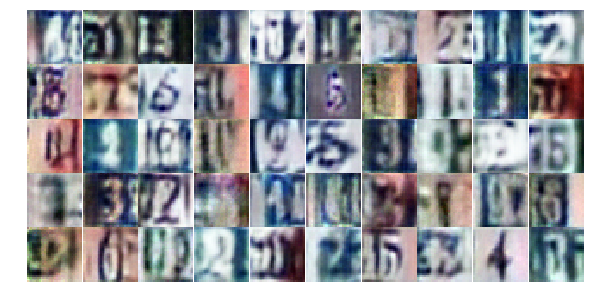

Epoch 7/25... Discriminator Loss: 0.8666... Generator Loss: 3.0883
Epoch 8/25... Discriminator Loss: 0.4937... Generator Loss: 1.2546
Epoch 8/25... Discriminator Loss: 0.4806... Generator Loss: 1.4043
Epoch 8/25... Discriminator Loss: 1.0944... Generator Loss: 0.6306
Epoch 8/25... Discriminator Loss: 0.9200... Generator Loss: 0.7625
Epoch 8/25... Discriminator Loss: 0.8691... Generator Loss: 1.1191
Epoch 8/25... Discriminator Loss: 0.9122... Generator Loss: 0.7576
Epoch 8/25... Discriminator Loss: 0.5639... Generator Loss: 2.8577
Epoch 8/25... Discriminator Loss: 0.6777... Generator Loss: 1.0067
Epoch 8/25... Discriminator Loss: 0.7439... Generator Loss: 0.9116


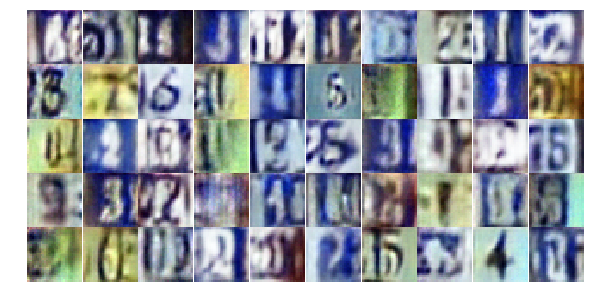

Epoch 8/25... Discriminator Loss: 0.4291... Generator Loss: 1.5913
Epoch 8/25... Discriminator Loss: 0.3863... Generator Loss: 1.6322
Epoch 8/25... Discriminator Loss: 1.2408... Generator Loss: 0.4777
Epoch 8/25... Discriminator Loss: 0.7782... Generator Loss: 3.3898
Epoch 8/25... Discriminator Loss: 1.1914... Generator Loss: 0.4860
Epoch 8/25... Discriminator Loss: 0.5644... Generator Loss: 1.3787
Epoch 8/25... Discriminator Loss: 0.4268... Generator Loss: 1.9452
Epoch 8/25... Discriminator Loss: 0.4090... Generator Loss: 1.8570
Epoch 8/25... Discriminator Loss: 0.7106... Generator Loss: 1.0833
Epoch 8/25... Discriminator Loss: 0.9399... Generator Loss: 0.9043


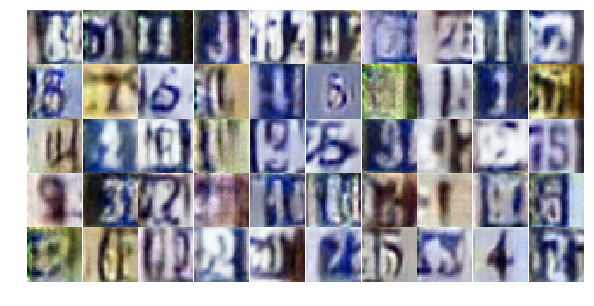

Epoch 8/25... Discriminator Loss: 0.4316... Generator Loss: 1.7659
Epoch 8/25... Discriminator Loss: 0.7653... Generator Loss: 0.8501
Epoch 8/25... Discriminator Loss: 0.6354... Generator Loss: 1.4792
Epoch 8/25... Discriminator Loss: 0.6934... Generator Loss: 1.1487
Epoch 8/25... Discriminator Loss: 0.4371... Generator Loss: 1.3711
Epoch 8/25... Discriminator Loss: 0.5176... Generator Loss: 1.4735
Epoch 8/25... Discriminator Loss: 1.4170... Generator Loss: 2.3207
Epoch 8/25... Discriminator Loss: 0.3071... Generator Loss: 1.7843
Epoch 8/25... Discriminator Loss: 0.6024... Generator Loss: 1.2892
Epoch 8/25... Discriminator Loss: 0.5827... Generator Loss: 1.5316


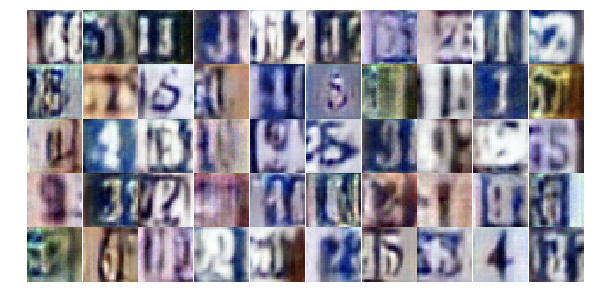

Epoch 8/25... Discriminator Loss: 0.7225... Generator Loss: 1.0139
Epoch 8/25... Discriminator Loss: 0.5506... Generator Loss: 1.2151
Epoch 8/25... Discriminator Loss: 0.5911... Generator Loss: 1.2448
Epoch 8/25... Discriminator Loss: 0.8333... Generator Loss: 0.8347
Epoch 8/25... Discriminator Loss: 0.7219... Generator Loss: 0.8780
Epoch 8/25... Discriminator Loss: 0.4325... Generator Loss: 1.5393
Epoch 8/25... Discriminator Loss: 0.7278... Generator Loss: 1.0812
Epoch 8/25... Discriminator Loss: 0.7299... Generator Loss: 0.9881
Epoch 8/25... Discriminator Loss: 0.5841... Generator Loss: 1.1297
Epoch 8/25... Discriminator Loss: 0.5790... Generator Loss: 1.0364


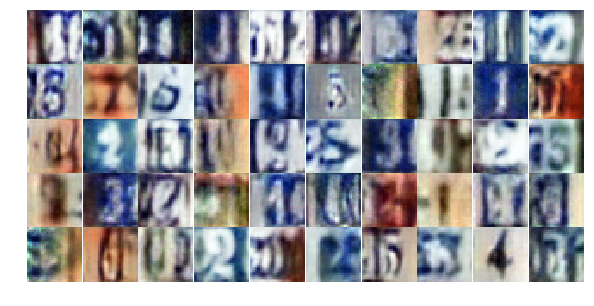

Epoch 8/25... Discriminator Loss: 0.7365... Generator Loss: 3.2619
Epoch 8/25... Discriminator Loss: 0.8861... Generator Loss: 0.8292
Epoch 8/25... Discriminator Loss: 0.7098... Generator Loss: 0.8211
Epoch 8/25... Discriminator Loss: 0.3683... Generator Loss: 1.8133
Epoch 8/25... Discriminator Loss: 1.2952... Generator Loss: 2.8898
Epoch 8/25... Discriminator Loss: 0.6643... Generator Loss: 1.0896
Epoch 8/25... Discriminator Loss: 0.4010... Generator Loss: 1.9716
Epoch 8/25... Discriminator Loss: 1.2191... Generator Loss: 0.5886
Epoch 8/25... Discriminator Loss: 0.4852... Generator Loss: 1.5707
Epoch 8/25... Discriminator Loss: 0.7860... Generator Loss: 0.8413


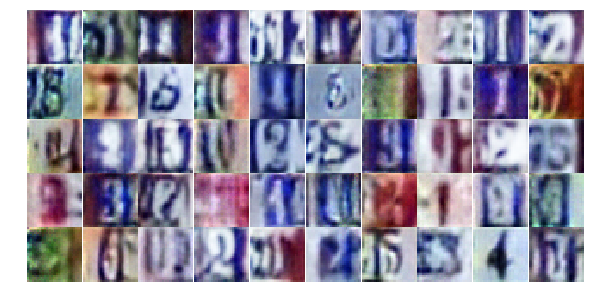

Epoch 8/25... Discriminator Loss: 0.4591... Generator Loss: 2.0673
Epoch 8/25... Discriminator Loss: 0.4327... Generator Loss: 1.6551
Epoch 8/25... Discriminator Loss: 0.5002... Generator Loss: 1.3246
Epoch 8/25... Discriminator Loss: 0.6109... Generator Loss: 1.0620
Epoch 8/25... Discriminator Loss: 0.5251... Generator Loss: 2.4616
Epoch 8/25... Discriminator Loss: 0.8643... Generator Loss: 0.8953
Epoch 8/25... Discriminator Loss: 0.7558... Generator Loss: 0.8339
Epoch 8/25... Discriminator Loss: 0.7153... Generator Loss: 2.5757
Epoch 9/25... Discriminator Loss: 0.9166... Generator Loss: 0.9995
Epoch 9/25... Discriminator Loss: 0.6688... Generator Loss: 0.9254


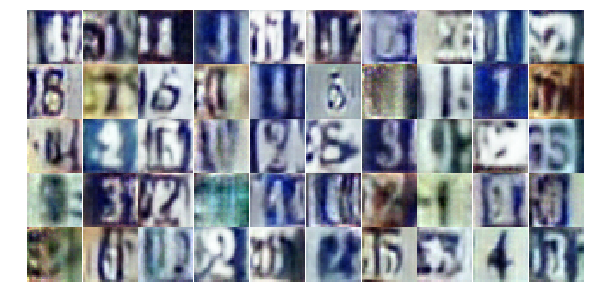

Epoch 9/25... Discriminator Loss: 0.5761... Generator Loss: 1.1942
Epoch 9/25... Discriminator Loss: 0.6908... Generator Loss: 0.9291
Epoch 9/25... Discriminator Loss: 0.9236... Generator Loss: 0.7000
Epoch 9/25... Discriminator Loss: 0.3350... Generator Loss: 2.0411
Epoch 9/25... Discriminator Loss: 1.0591... Generator Loss: 0.5782
Epoch 9/25... Discriminator Loss: 1.0274... Generator Loss: 3.3241
Epoch 9/25... Discriminator Loss: 0.6909... Generator Loss: 1.0710
Epoch 9/25... Discriminator Loss: 0.5961... Generator Loss: 1.1454
Epoch 9/25... Discriminator Loss: 0.7507... Generator Loss: 1.0431
Epoch 9/25... Discriminator Loss: 0.4784... Generator Loss: 1.8713


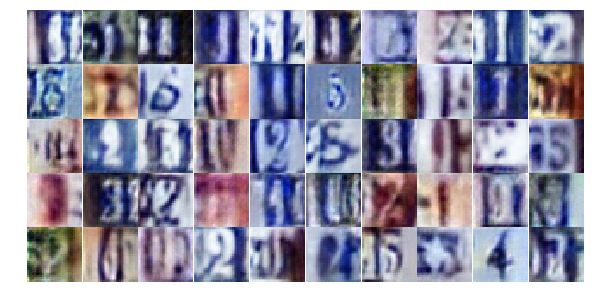

Epoch 9/25... Discriminator Loss: 0.8370... Generator Loss: 0.7306
Epoch 9/25... Discriminator Loss: 2.5437... Generator Loss: 3.3379
Epoch 9/25... Discriminator Loss: 0.7885... Generator Loss: 1.9027
Epoch 9/25... Discriminator Loss: 0.6702... Generator Loss: 1.1224
Epoch 9/25... Discriminator Loss: 0.6062... Generator Loss: 1.2532
Epoch 9/25... Discriminator Loss: 0.5458... Generator Loss: 1.2301
Epoch 9/25... Discriminator Loss: 1.0781... Generator Loss: 0.5456
Epoch 9/25... Discriminator Loss: 0.3947... Generator Loss: 1.7918
Epoch 9/25... Discriminator Loss: 0.9522... Generator Loss: 0.7027
Epoch 9/25... Discriminator Loss: 0.7617... Generator Loss: 0.8646


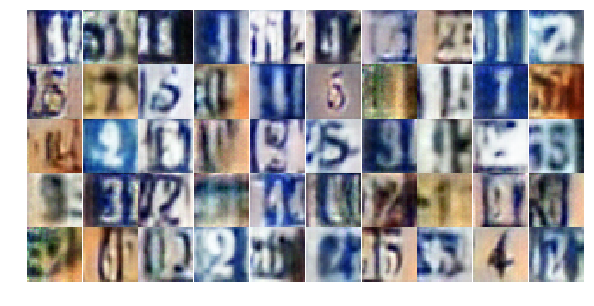

Epoch 9/25... Discriminator Loss: 0.7800... Generator Loss: 0.9309
Epoch 9/25... Discriminator Loss: 0.4202... Generator Loss: 1.5558
Epoch 9/25... Discriminator Loss: 0.4652... Generator Loss: 1.8905
Epoch 9/25... Discriminator Loss: 0.6215... Generator Loss: 1.1797
Epoch 9/25... Discriminator Loss: 0.4934... Generator Loss: 3.2022
Epoch 9/25... Discriminator Loss: 0.5591... Generator Loss: 1.2899
Epoch 9/25... Discriminator Loss: 0.5758... Generator Loss: 1.1840
Epoch 9/25... Discriminator Loss: 0.6354... Generator Loss: 1.0961
Epoch 9/25... Discriminator Loss: 0.4436... Generator Loss: 1.4455
Epoch 9/25... Discriminator Loss: 0.9027... Generator Loss: 0.6901


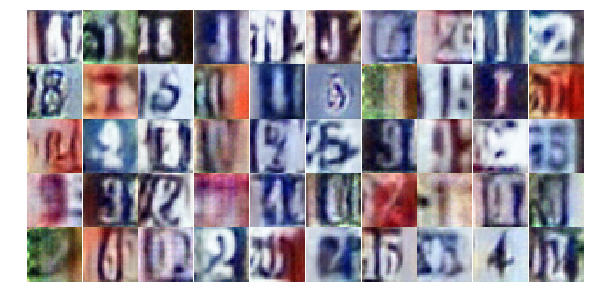

Epoch 9/25... Discriminator Loss: 0.7747... Generator Loss: 0.9271
Epoch 9/25... Discriminator Loss: 0.4574... Generator Loss: 1.3572
Epoch 9/25... Discriminator Loss: 1.0783... Generator Loss: 0.6366
Epoch 9/25... Discriminator Loss: 0.4923... Generator Loss: 1.7770
Epoch 9/25... Discriminator Loss: 1.0021... Generator Loss: 0.6101
Epoch 9/25... Discriminator Loss: 0.8370... Generator Loss: 1.4358
Epoch 9/25... Discriminator Loss: 0.4786... Generator Loss: 1.4629
Epoch 9/25... Discriminator Loss: 0.3359... Generator Loss: 2.1007
Epoch 9/25... Discriminator Loss: 1.0761... Generator Loss: 0.5703
Epoch 9/25... Discriminator Loss: 0.6782... Generator Loss: 1.0594


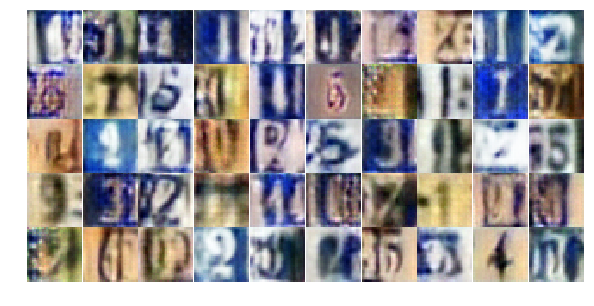

Epoch 9/25... Discriminator Loss: 0.4973... Generator Loss: 1.4063
Epoch 9/25... Discriminator Loss: 0.3752... Generator Loss: 1.8031
Epoch 9/25... Discriminator Loss: 1.2534... Generator Loss: 0.5730
Epoch 9/25... Discriminator Loss: 0.5999... Generator Loss: 1.6918
Epoch 9/25... Discriminator Loss: 0.5317... Generator Loss: 2.1193
Epoch 9/25... Discriminator Loss: 0.8245... Generator Loss: 0.9491
Epoch 9/25... Discriminator Loss: 0.9444... Generator Loss: 0.7279
Epoch 9/25... Discriminator Loss: 1.0329... Generator Loss: 0.5750
Epoch 9/25... Discriminator Loss: 0.7071... Generator Loss: 0.9800
Epoch 9/25... Discriminator Loss: 0.6104... Generator Loss: 1.6426


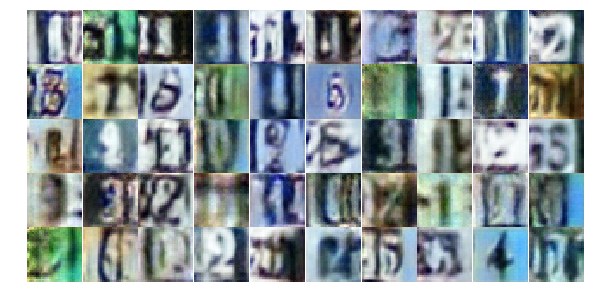

Epoch 9/25... Discriminator Loss: 1.2237... Generator Loss: 0.5366
Epoch 9/25... Discriminator Loss: 1.0803... Generator Loss: 2.8706
Epoch 9/25... Discriminator Loss: 0.6130... Generator Loss: 1.3180
Epoch 9/25... Discriminator Loss: 0.5800... Generator Loss: 1.2563
Epoch 9/25... Discriminator Loss: 0.9363... Generator Loss: 0.6822
Epoch 10/25... Discriminator Loss: 0.4407... Generator Loss: 1.7587
Epoch 10/25... Discriminator Loss: 0.5788... Generator Loss: 1.2783
Epoch 10/25... Discriminator Loss: 0.4612... Generator Loss: 1.3070
Epoch 10/25... Discriminator Loss: 0.7872... Generator Loss: 0.8299
Epoch 10/25... Discriminator Loss: 1.3839... Generator Loss: 0.3825


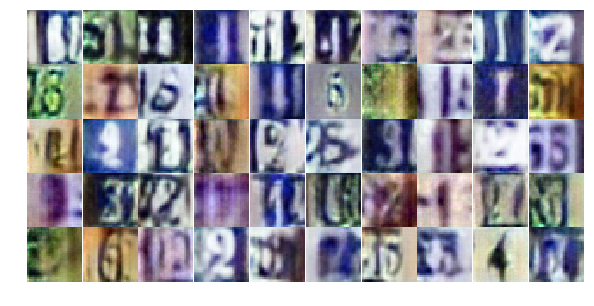

Epoch 10/25... Discriminator Loss: 1.2171... Generator Loss: 0.4685
Epoch 10/25... Discriminator Loss: 0.5003... Generator Loss: 1.2349
Epoch 10/25... Discriminator Loss: 1.2183... Generator Loss: 0.4632
Epoch 10/25... Discriminator Loss: 0.5501... Generator Loss: 1.4548
Epoch 10/25... Discriminator Loss: 1.1959... Generator Loss: 4.2334
Epoch 10/25... Discriminator Loss: 0.8899... Generator Loss: 0.8275
Epoch 10/25... Discriminator Loss: 0.5407... Generator Loss: 1.4098
Epoch 10/25... Discriminator Loss: 1.0373... Generator Loss: 0.6750
Epoch 10/25... Discriminator Loss: 2.3850... Generator Loss: 0.2035
Epoch 10/25... Discriminator Loss: 0.9659... Generator Loss: 2.2950


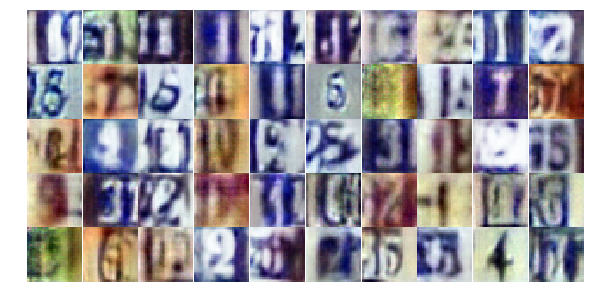

Epoch 10/25... Discriminator Loss: 0.6015... Generator Loss: 1.4495
Epoch 10/25... Discriminator Loss: 1.0833... Generator Loss: 0.5656
Epoch 10/25... Discriminator Loss: 0.6535... Generator Loss: 1.0118
Epoch 10/25... Discriminator Loss: 0.9590... Generator Loss: 0.7202
Epoch 10/25... Discriminator Loss: 0.5371... Generator Loss: 1.3405
Epoch 10/25... Discriminator Loss: 0.5718... Generator Loss: 1.2557
Epoch 10/25... Discriminator Loss: 0.7991... Generator Loss: 0.8096
Epoch 10/25... Discriminator Loss: 0.4954... Generator Loss: 1.4512
Epoch 10/25... Discriminator Loss: 0.5421... Generator Loss: 1.3411
Epoch 10/25... Discriminator Loss: 0.3662... Generator Loss: 2.3822


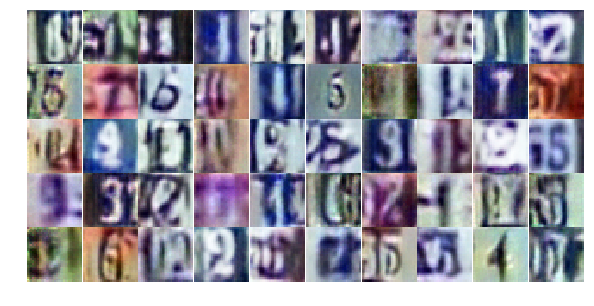

Epoch 10/25... Discriminator Loss: 0.6710... Generator Loss: 0.9822
Epoch 10/25... Discriminator Loss: 0.7910... Generator Loss: 0.8805
Epoch 10/25... Discriminator Loss: 0.5218... Generator Loss: 1.2482
Epoch 10/25... Discriminator Loss: 0.4790... Generator Loss: 2.3713
Epoch 10/25... Discriminator Loss: 1.5440... Generator Loss: 0.3254
Epoch 10/25... Discriminator Loss: 0.8103... Generator Loss: 0.9266
Epoch 10/25... Discriminator Loss: 0.3701... Generator Loss: 2.0242
Epoch 10/25... Discriminator Loss: 0.8721... Generator Loss: 0.7066
Epoch 10/25... Discriminator Loss: 0.6571... Generator Loss: 0.9730
Epoch 10/25... Discriminator Loss: 0.6473... Generator Loss: 0.9120


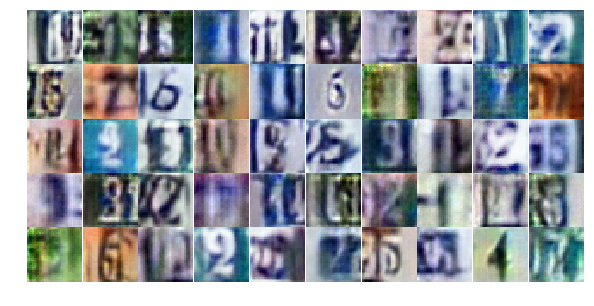

Epoch 10/25... Discriminator Loss: 0.4689... Generator Loss: 1.9127
Epoch 10/25... Discriminator Loss: 0.5242... Generator Loss: 1.2478
Epoch 10/25... Discriminator Loss: 0.6253... Generator Loss: 1.2426
Epoch 10/25... Discriminator Loss: 0.7443... Generator Loss: 1.6913
Epoch 10/25... Discriminator Loss: 1.0257... Generator Loss: 0.5966
Epoch 10/25... Discriminator Loss: 1.3690... Generator Loss: 0.4149
Epoch 10/25... Discriminator Loss: 0.6516... Generator Loss: 1.0925
Epoch 10/25... Discriminator Loss: 1.0321... Generator Loss: 0.6834
Epoch 10/25... Discriminator Loss: 0.6235... Generator Loss: 1.1143
Epoch 10/25... Discriminator Loss: 0.6381... Generator Loss: 2.5170


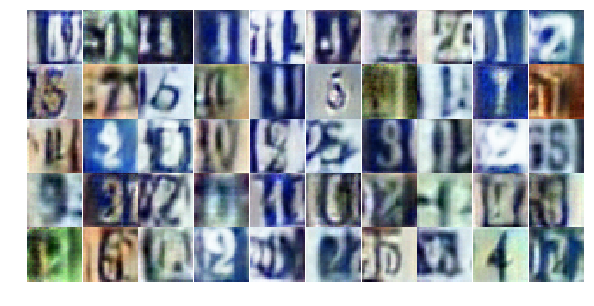

Epoch 10/25... Discriminator Loss: 1.2602... Generator Loss: 0.5318
Epoch 10/25... Discriminator Loss: 1.1457... Generator Loss: 0.5511
Epoch 10/25... Discriminator Loss: 2.4700... Generator Loss: 0.1836
Epoch 10/25... Discriminator Loss: 1.1261... Generator Loss: 0.7015
Epoch 10/25... Discriminator Loss: 0.7372... Generator Loss: 1.3907
Epoch 10/25... Discriminator Loss: 0.6275... Generator Loss: 1.4168
Epoch 10/25... Discriminator Loss: 0.7425... Generator Loss: 1.0331
Epoch 10/25... Discriminator Loss: 0.5013... Generator Loss: 1.4539
Epoch 10/25... Discriminator Loss: 0.6375... Generator Loss: 1.3010
Epoch 10/25... Discriminator Loss: 0.6594... Generator Loss: 1.1280


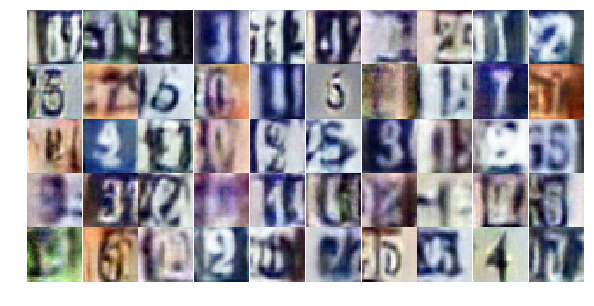

Epoch 10/25... Discriminator Loss: 0.8234... Generator Loss: 1.0638
Epoch 10/25... Discriminator Loss: 0.4550... Generator Loss: 1.6280
Epoch 10/25... Discriminator Loss: 0.4781... Generator Loss: 1.2985
Epoch 11/25... Discriminator Loss: 0.9658... Generator Loss: 0.7051
Epoch 11/25... Discriminator Loss: 0.8372... Generator Loss: 0.8203
Epoch 11/25... Discriminator Loss: 1.0299... Generator Loss: 0.6662
Epoch 11/25... Discriminator Loss: 0.6352... Generator Loss: 1.1569
Epoch 11/25... Discriminator Loss: 0.5018... Generator Loss: 2.1538
Epoch 11/25... Discriminator Loss: 1.7954... Generator Loss: 0.2292
Epoch 11/25... Discriminator Loss: 0.5054... Generator Loss: 1.8758


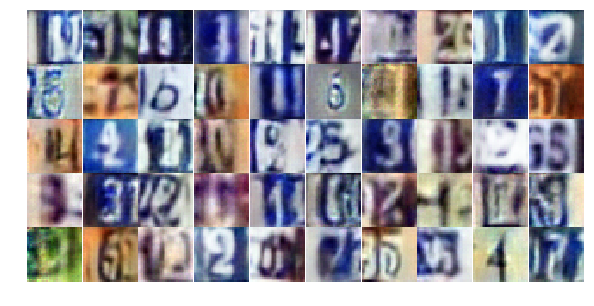

Epoch 11/25... Discriminator Loss: 0.4862... Generator Loss: 1.4115
Epoch 11/25... Discriminator Loss: 0.5264... Generator Loss: 1.4762
Epoch 11/25... Discriminator Loss: 0.5030... Generator Loss: 1.2944
Epoch 11/25... Discriminator Loss: 0.6378... Generator Loss: 1.1532
Epoch 11/25... Discriminator Loss: 0.7058... Generator Loss: 1.2092
Epoch 11/25... Discriminator Loss: 0.4510... Generator Loss: 1.5671
Epoch 11/25... Discriminator Loss: 0.8866... Generator Loss: 0.8641
Epoch 11/25... Discriminator Loss: 0.4486... Generator Loss: 1.4993
Epoch 11/25... Discriminator Loss: 0.7573... Generator Loss: 0.8953
Epoch 11/25... Discriminator Loss: 1.8022... Generator Loss: 0.3007


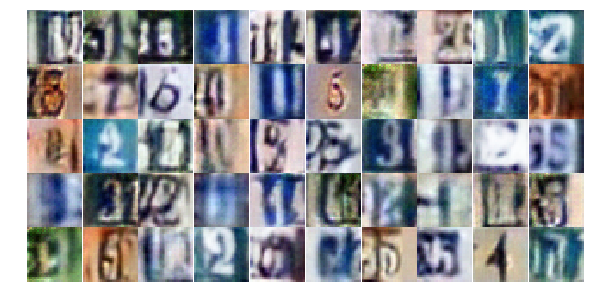

Epoch 11/25... Discriminator Loss: 0.7651... Generator Loss: 0.9307
Epoch 11/25... Discriminator Loss: 0.4223... Generator Loss: 1.9258
Epoch 11/25... Discriminator Loss: 0.6893... Generator Loss: 0.9611
Epoch 11/25... Discriminator Loss: 0.6735... Generator Loss: 0.9652
Epoch 11/25... Discriminator Loss: 0.3630... Generator Loss: 1.7559
Epoch 11/25... Discriminator Loss: 0.4045... Generator Loss: 1.7748
Epoch 11/25... Discriminator Loss: 0.5226... Generator Loss: 1.2702
Epoch 11/25... Discriminator Loss: 0.8725... Generator Loss: 1.1844
Epoch 11/25... Discriminator Loss: 0.2622... Generator Loss: 2.1265
Epoch 11/25... Discriminator Loss: 0.8170... Generator Loss: 0.7520


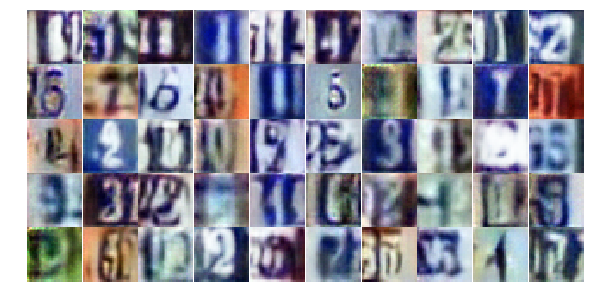

Epoch 11/25... Discriminator Loss: 0.9723... Generator Loss: 0.7113
Epoch 11/25... Discriminator Loss: 0.8549... Generator Loss: 2.3074
Epoch 11/25... Discriminator Loss: 0.8494... Generator Loss: 0.8304
Epoch 11/25... Discriminator Loss: 0.5153... Generator Loss: 1.2484
Epoch 11/25... Discriminator Loss: 0.5947... Generator Loss: 1.1684
Epoch 11/25... Discriminator Loss: 1.5998... Generator Loss: 0.3156
Epoch 11/25... Discriminator Loss: 0.7459... Generator Loss: 0.9340
Epoch 11/25... Discriminator Loss: 1.2009... Generator Loss: 0.4943
Epoch 11/25... Discriminator Loss: 0.5865... Generator Loss: 1.1940
Epoch 11/25... Discriminator Loss: 1.0035... Generator Loss: 0.6632


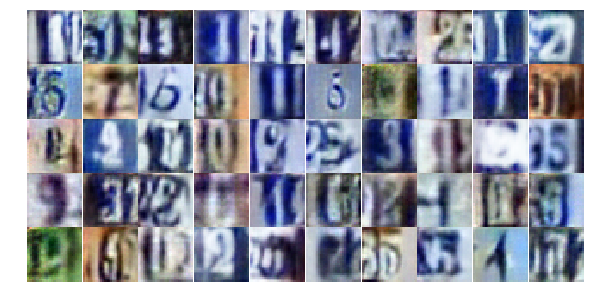

Epoch 11/25... Discriminator Loss: 0.4873... Generator Loss: 1.8066
Epoch 11/25... Discriminator Loss: 0.5333... Generator Loss: 1.3864
Epoch 11/25... Discriminator Loss: 0.9320... Generator Loss: 0.7712
Epoch 11/25... Discriminator Loss: 0.7084... Generator Loss: 1.2153
Epoch 11/25... Discriminator Loss: 0.8032... Generator Loss: 0.8371
Epoch 11/25... Discriminator Loss: 0.7013... Generator Loss: 0.9203
Epoch 11/25... Discriminator Loss: 0.3462... Generator Loss: 1.8622
Epoch 11/25... Discriminator Loss: 0.8077... Generator Loss: 0.8489
Epoch 11/25... Discriminator Loss: 1.2630... Generator Loss: 0.5154
Epoch 11/25... Discriminator Loss: 0.5473... Generator Loss: 1.2108


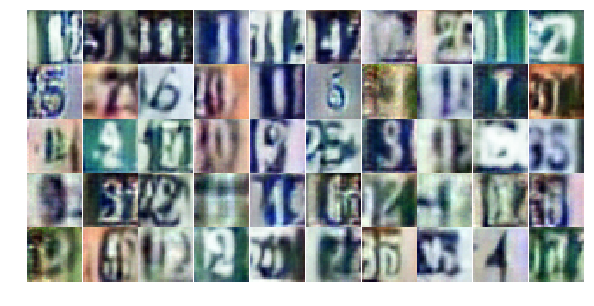

Epoch 11/25... Discriminator Loss: 0.5148... Generator Loss: 1.3030
Epoch 11/25... Discriminator Loss: 0.5430... Generator Loss: 1.3010
Epoch 11/25... Discriminator Loss: 0.7336... Generator Loss: 0.9573
Epoch 11/25... Discriminator Loss: 0.6438... Generator Loss: 1.0079
Epoch 11/25... Discriminator Loss: 1.6421... Generator Loss: 0.2941
Epoch 11/25... Discriminator Loss: 0.9546... Generator Loss: 1.2056
Epoch 11/25... Discriminator Loss: 0.5691... Generator Loss: 1.3332
Epoch 11/25... Discriminator Loss: 0.9763... Generator Loss: 2.9025
Epoch 11/25... Discriminator Loss: 0.8834... Generator Loss: 0.8222
Epoch 11/25... Discriminator Loss: 0.4969... Generator Loss: 1.4093


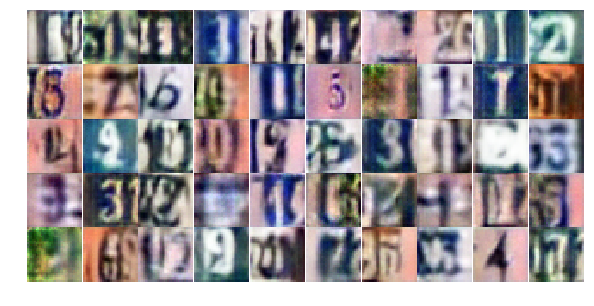

Epoch 12/25... Discriminator Loss: 0.5387... Generator Loss: 1.7610
Epoch 12/25... Discriminator Loss: 0.6057... Generator Loss: 1.3917
Epoch 12/25... Discriminator Loss: 0.6949... Generator Loss: 1.2482
Epoch 12/25... Discriminator Loss: 0.5584... Generator Loss: 1.4830
Epoch 12/25... Discriminator Loss: 0.4247... Generator Loss: 1.9107
Epoch 12/25... Discriminator Loss: 0.9925... Generator Loss: 0.7242
Epoch 12/25... Discriminator Loss: 0.4953... Generator Loss: 1.3541
Epoch 12/25... Discriminator Loss: 0.4594... Generator Loss: 1.8105
Epoch 12/25... Discriminator Loss: 0.6406... Generator Loss: 1.8279
Epoch 12/25... Discriminator Loss: 1.2546... Generator Loss: 0.5175


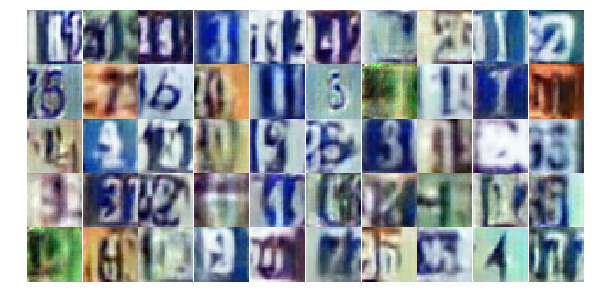

Epoch 12/25... Discriminator Loss: 0.5131... Generator Loss: 1.2445
Epoch 12/25... Discriminator Loss: 0.9232... Generator Loss: 0.6940
Epoch 12/25... Discriminator Loss: 0.5329... Generator Loss: 1.7282
Epoch 12/25... Discriminator Loss: 1.2869... Generator Loss: 2.9443
Epoch 12/25... Discriminator Loss: 0.5074... Generator Loss: 1.9914
Epoch 12/25... Discriminator Loss: 1.7264... Generator Loss: 0.6289
Epoch 12/25... Discriminator Loss: 1.5526... Generator Loss: 0.3460
Epoch 12/25... Discriminator Loss: 0.3072... Generator Loss: 1.9115
Epoch 12/25... Discriminator Loss: 0.6131... Generator Loss: 1.0077
Epoch 12/25... Discriminator Loss: 0.8992... Generator Loss: 0.7513


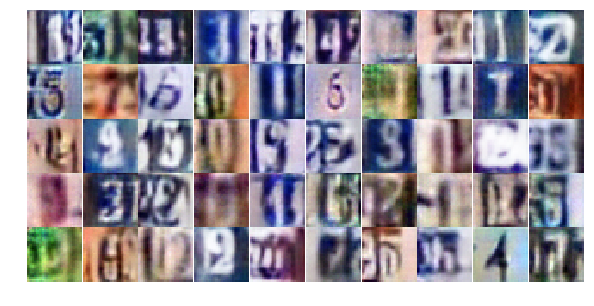

Epoch 12/25... Discriminator Loss: 0.3615... Generator Loss: 1.5686
Epoch 12/25... Discriminator Loss: 0.4648... Generator Loss: 1.3998
Epoch 12/25... Discriminator Loss: 0.5954... Generator Loss: 1.1475
Epoch 12/25... Discriminator Loss: 0.5425... Generator Loss: 1.5855
Epoch 12/25... Discriminator Loss: 0.3484... Generator Loss: 1.9269
Epoch 12/25... Discriminator Loss: 0.5656... Generator Loss: 1.2074
Epoch 12/25... Discriminator Loss: 0.5745... Generator Loss: 1.1990
Epoch 12/25... Discriminator Loss: 0.3047... Generator Loss: 1.9242
Epoch 12/25... Discriminator Loss: 0.5076... Generator Loss: 1.2336
Epoch 12/25... Discriminator Loss: 0.4504... Generator Loss: 1.5027


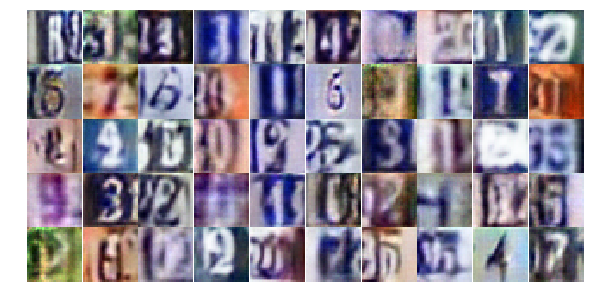

Epoch 12/25... Discriminator Loss: 0.7001... Generator Loss: 0.9221
Epoch 12/25... Discriminator Loss: 0.8013... Generator Loss: 1.0488
Epoch 12/25... Discriminator Loss: 0.7499... Generator Loss: 0.8697
Epoch 12/25... Discriminator Loss: 1.5787... Generator Loss: 0.3447
Epoch 12/25... Discriminator Loss: 0.9460... Generator Loss: 2.8848
Epoch 12/25... Discriminator Loss: 1.0185... Generator Loss: 0.7112
Epoch 12/25... Discriminator Loss: 1.1908... Generator Loss: 0.5022
Epoch 12/25... Discriminator Loss: 0.8021... Generator Loss: 1.0259
Epoch 12/25... Discriminator Loss: 0.5221... Generator Loss: 1.3587
Epoch 12/25... Discriminator Loss: 0.2837... Generator Loss: 2.0424


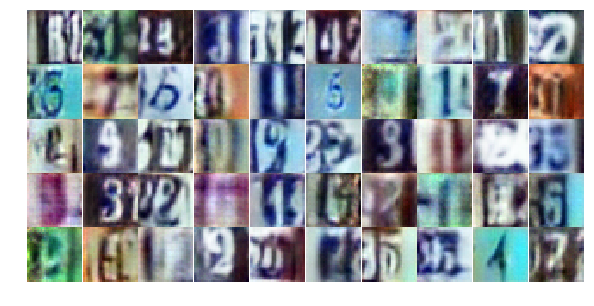

Epoch 12/25... Discriminator Loss: 0.7523... Generator Loss: 1.8477
Epoch 12/25... Discriminator Loss: 0.4183... Generator Loss: 1.9722
Epoch 12/25... Discriminator Loss: 0.4315... Generator Loss: 1.5689
Epoch 12/25... Discriminator Loss: 0.9913... Generator Loss: 0.6730
Epoch 12/25... Discriminator Loss: 0.6791... Generator Loss: 1.0907
Epoch 12/25... Discriminator Loss: 0.9395... Generator Loss: 0.7439
Epoch 12/25... Discriminator Loss: 0.4787... Generator Loss: 1.5626
Epoch 12/25... Discriminator Loss: 0.7102... Generator Loss: 0.9532
Epoch 12/25... Discriminator Loss: 0.6341... Generator Loss: 1.1198
Epoch 12/25... Discriminator Loss: 0.8957... Generator Loss: 0.6940


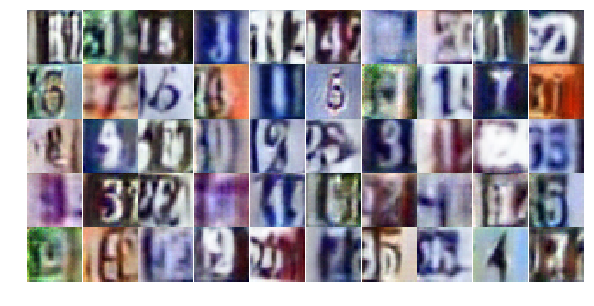

Epoch 12/25... Discriminator Loss: 0.8694... Generator Loss: 0.8418
Epoch 12/25... Discriminator Loss: 0.6663... Generator Loss: 1.1231
Epoch 12/25... Discriminator Loss: 0.6780... Generator Loss: 1.1773
Epoch 12/25... Discriminator Loss: 0.8956... Generator Loss: 0.7592
Epoch 12/25... Discriminator Loss: 0.5220... Generator Loss: 1.3065
Epoch 12/25... Discriminator Loss: 0.6188... Generator Loss: 2.3415
Epoch 12/25... Discriminator Loss: 1.3995... Generator Loss: 0.3767
Epoch 13/25... Discriminator Loss: 0.5333... Generator Loss: 1.2279
Epoch 13/25... Discriminator Loss: 0.3569... Generator Loss: 1.8423
Epoch 13/25... Discriminator Loss: 0.8936... Generator Loss: 0.7162


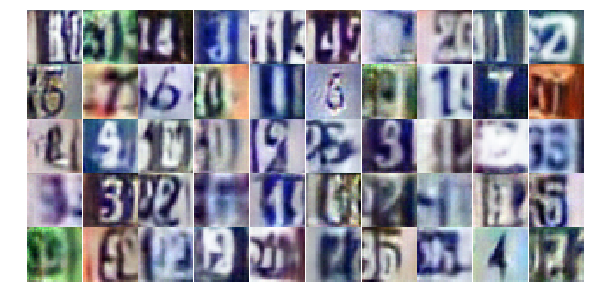

Epoch 13/25... Discriminator Loss: 0.8534... Generator Loss: 0.8061
Epoch 13/25... Discriminator Loss: 0.8379... Generator Loss: 2.4066
Epoch 13/25... Discriminator Loss: 1.2451... Generator Loss: 0.5251
Epoch 13/25... Discriminator Loss: 1.0181... Generator Loss: 0.6874
Epoch 13/25... Discriminator Loss: 1.2390... Generator Loss: 0.5002
Epoch 13/25... Discriminator Loss: 0.6144... Generator Loss: 1.1693
Epoch 13/25... Discriminator Loss: 0.4310... Generator Loss: 1.8524
Epoch 13/25... Discriminator Loss: 0.8107... Generator Loss: 0.7846
Epoch 13/25... Discriminator Loss: 0.4829... Generator Loss: 1.2747
Epoch 13/25... Discriminator Loss: 0.4606... Generator Loss: 1.4798


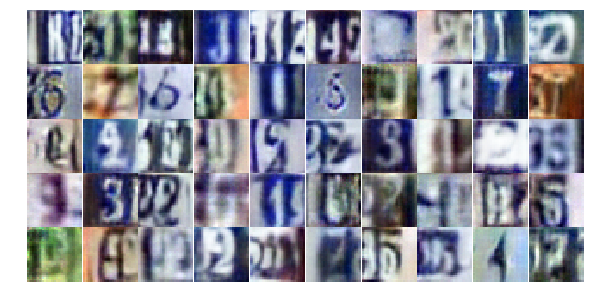

Epoch 13/25... Discriminator Loss: 0.5874... Generator Loss: 2.2181
Epoch 13/25... Discriminator Loss: 2.2834... Generator Loss: 4.2997
Epoch 13/25... Discriminator Loss: 1.3688... Generator Loss: 0.5169
Epoch 13/25... Discriminator Loss: 1.1750... Generator Loss: 0.5432
Epoch 13/25... Discriminator Loss: 0.6232... Generator Loss: 1.3799
Epoch 13/25... Discriminator Loss: 1.0814... Generator Loss: 0.5680
Epoch 13/25... Discriminator Loss: 0.7738... Generator Loss: 0.8733
Epoch 13/25... Discriminator Loss: 0.9781... Generator Loss: 0.6518
Epoch 13/25... Discriminator Loss: 0.4747... Generator Loss: 1.3918
Epoch 13/25... Discriminator Loss: 0.7772... Generator Loss: 0.8486


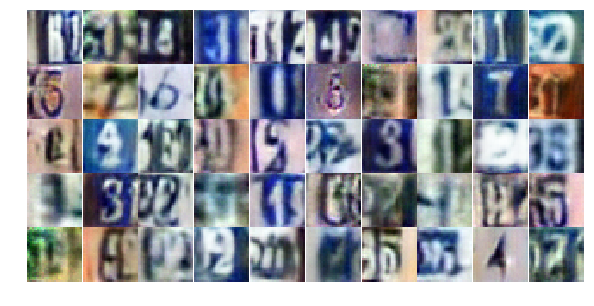

Epoch 13/25... Discriminator Loss: 0.6554... Generator Loss: 1.0129
Epoch 13/25... Discriminator Loss: 0.6081... Generator Loss: 1.2575
Epoch 13/25... Discriminator Loss: 0.8578... Generator Loss: 1.0105
Epoch 13/25... Discriminator Loss: 0.4943... Generator Loss: 1.3872
Epoch 13/25... Discriminator Loss: 0.6784... Generator Loss: 1.7892
Epoch 13/25... Discriminator Loss: 0.6147... Generator Loss: 1.2397
Epoch 13/25... Discriminator Loss: 0.7755... Generator Loss: 1.2829
Epoch 13/25... Discriminator Loss: 0.5336... Generator Loss: 1.2918
Epoch 13/25... Discriminator Loss: 0.5471... Generator Loss: 1.4765
Epoch 13/25... Discriminator Loss: 0.4444... Generator Loss: 1.6243


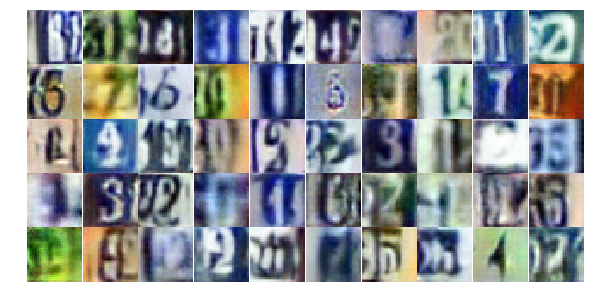

Epoch 13/25... Discriminator Loss: 0.8934... Generator Loss: 0.7243
Epoch 13/25... Discriminator Loss: 1.2262... Generator Loss: 2.9001
Epoch 13/25... Discriminator Loss: 0.8382... Generator Loss: 0.8239
Epoch 13/25... Discriminator Loss: 1.1463... Generator Loss: 0.5153
Epoch 13/25... Discriminator Loss: 0.4974... Generator Loss: 1.3463
Epoch 13/25... Discriminator Loss: 0.4270... Generator Loss: 1.5052
Epoch 13/25... Discriminator Loss: 0.4594... Generator Loss: 1.3425
Epoch 13/25... Discriminator Loss: 0.9081... Generator Loss: 0.7083
Epoch 13/25... Discriminator Loss: 0.6143... Generator Loss: 1.0903
Epoch 13/25... Discriminator Loss: 0.7967... Generator Loss: 0.8226


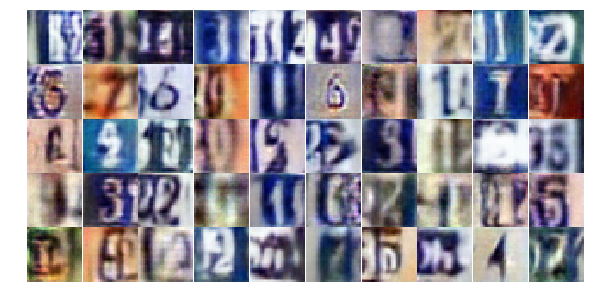

Epoch 13/25... Discriminator Loss: 0.4955... Generator Loss: 1.2954
Epoch 13/25... Discriminator Loss: 1.2665... Generator Loss: 0.5062
Epoch 13/25... Discriminator Loss: 0.8725... Generator Loss: 0.7944
Epoch 13/25... Discriminator Loss: 0.6098... Generator Loss: 1.2514
Epoch 13/25... Discriminator Loss: 1.0694... Generator Loss: 0.5629
Epoch 13/25... Discriminator Loss: 0.5248... Generator Loss: 1.6242
Epoch 13/25... Discriminator Loss: 0.6671... Generator Loss: 1.1461
Epoch 13/25... Discriminator Loss: 0.6204... Generator Loss: 1.1818
Epoch 13/25... Discriminator Loss: 0.7668... Generator Loss: 0.8822
Epoch 13/25... Discriminator Loss: 1.0727... Generator Loss: 0.5624


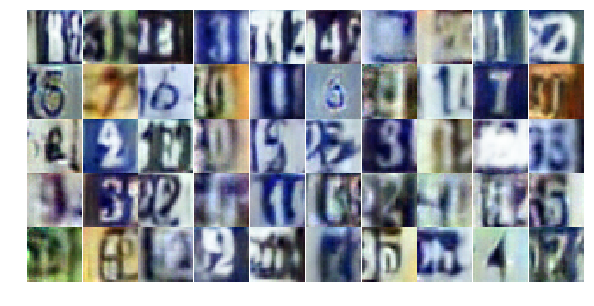

Epoch 13/25... Discriminator Loss: 0.3407... Generator Loss: 1.6323
Epoch 13/25... Discriminator Loss: 1.3105... Generator Loss: 0.4212
Epoch 13/25... Discriminator Loss: 0.7588... Generator Loss: 0.9371
Epoch 13/25... Discriminator Loss: 1.4438... Generator Loss: 0.4148
Epoch 14/25... Discriminator Loss: 1.0343... Generator Loss: 1.0193
Epoch 14/25... Discriminator Loss: 0.6507... Generator Loss: 1.2371
Epoch 14/25... Discriminator Loss: 1.3294... Generator Loss: 0.4335
Epoch 14/25... Discriminator Loss: 0.8740... Generator Loss: 2.1731
Epoch 14/25... Discriminator Loss: 0.6335... Generator Loss: 1.6546
Epoch 14/25... Discriminator Loss: 1.5755... Generator Loss: 0.3649


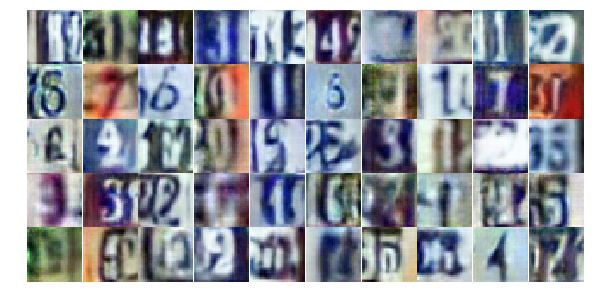

Epoch 14/25... Discriminator Loss: 0.7463... Generator Loss: 1.5774
Epoch 14/25... Discriminator Loss: 0.5736... Generator Loss: 1.1054
Epoch 14/25... Discriminator Loss: 0.9271... Generator Loss: 0.7401
Epoch 14/25... Discriminator Loss: 0.6735... Generator Loss: 1.3618
Epoch 14/25... Discriminator Loss: 1.0402... Generator Loss: 0.6184
Epoch 14/25... Discriminator Loss: 0.3112... Generator Loss: 2.1435
Epoch 14/25... Discriminator Loss: 0.3689... Generator Loss: 2.3009
Epoch 14/25... Discriminator Loss: 1.4699... Generator Loss: 0.3568
Epoch 14/25... Discriminator Loss: 1.4876... Generator Loss: 0.3497
Epoch 14/25... Discriminator Loss: 2.1408... Generator Loss: 0.1843


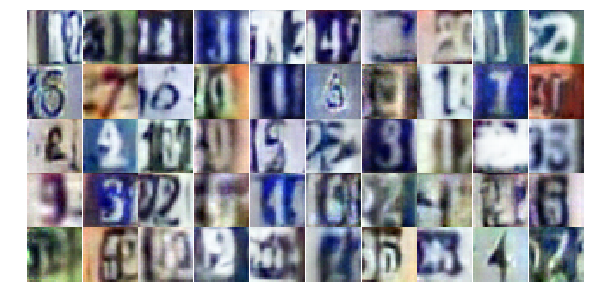

Epoch 14/25... Discriminator Loss: 0.4313... Generator Loss: 2.0297
Epoch 14/25... Discriminator Loss: 0.6590... Generator Loss: 2.0368
Epoch 14/25... Discriminator Loss: 0.7429... Generator Loss: 1.0022
Epoch 14/25... Discriminator Loss: 0.6671... Generator Loss: 1.1744
Epoch 14/25... Discriminator Loss: 0.8408... Generator Loss: 1.2682
Epoch 14/25... Discriminator Loss: 0.8107... Generator Loss: 0.9147
Epoch 14/25... Discriminator Loss: 0.6838... Generator Loss: 1.0583
Epoch 14/25... Discriminator Loss: 0.8412... Generator Loss: 0.7998
Epoch 14/25... Discriminator Loss: 0.4962... Generator Loss: 1.5281
Epoch 14/25... Discriminator Loss: 0.5046... Generator Loss: 1.4144


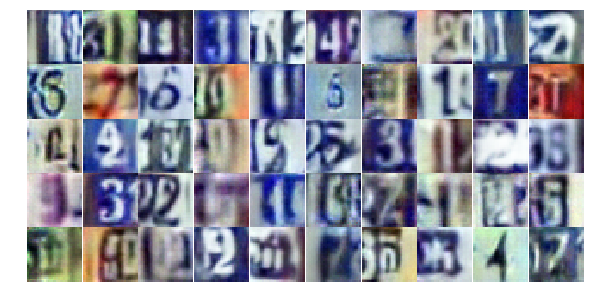

Epoch 14/25... Discriminator Loss: 1.5186... Generator Loss: 0.3423
Epoch 14/25... Discriminator Loss: 0.5122... Generator Loss: 1.2348
Epoch 14/25... Discriminator Loss: 0.5853... Generator Loss: 1.1638
Epoch 14/25... Discriminator Loss: 0.3465... Generator Loss: 1.7149
Epoch 14/25... Discriminator Loss: 0.5720... Generator Loss: 1.1561
Epoch 14/25... Discriminator Loss: 0.6094... Generator Loss: 1.1063
Epoch 14/25... Discriminator Loss: 0.7346... Generator Loss: 0.9678
Epoch 14/25... Discriminator Loss: 0.3420... Generator Loss: 1.7603
Epoch 14/25... Discriminator Loss: 0.2860... Generator Loss: 2.6609
Epoch 14/25... Discriminator Loss: 0.6873... Generator Loss: 1.1318


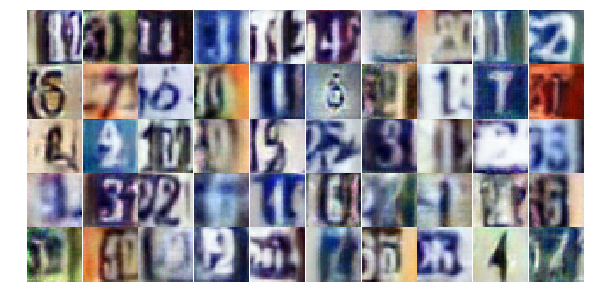

Epoch 14/25... Discriminator Loss: 1.2319... Generator Loss: 0.4786
Epoch 14/25... Discriminator Loss: 0.7474... Generator Loss: 1.2526
Epoch 14/25... Discriminator Loss: 1.1468... Generator Loss: 0.5157
Epoch 14/25... Discriminator Loss: 1.1291... Generator Loss: 0.6294
Epoch 14/25... Discriminator Loss: 1.3611... Generator Loss: 0.4087
Epoch 14/25... Discriminator Loss: 0.4843... Generator Loss: 1.4491
Epoch 14/25... Discriminator Loss: 0.6833... Generator Loss: 1.3755
Epoch 14/25... Discriminator Loss: 0.5355... Generator Loss: 1.3067
Epoch 14/25... Discriminator Loss: 1.1752... Generator Loss: 2.7231
Epoch 14/25... Discriminator Loss: 1.9003... Generator Loss: 0.3240


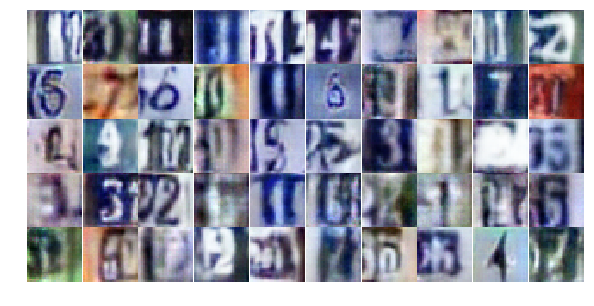

Epoch 14/25... Discriminator Loss: 1.0154... Generator Loss: 1.4822
Epoch 14/25... Discriminator Loss: 1.0384... Generator Loss: 0.6703
Epoch 14/25... Discriminator Loss: 0.6133... Generator Loss: 1.0712
Epoch 14/25... Discriminator Loss: 0.5708... Generator Loss: 1.2398
Epoch 14/25... Discriminator Loss: 0.5864... Generator Loss: 1.2341
Epoch 14/25... Discriminator Loss: 0.6211... Generator Loss: 1.1535
Epoch 14/25... Discriminator Loss: 0.6858... Generator Loss: 1.3208
Epoch 14/25... Discriminator Loss: 0.6360... Generator Loss: 1.0513
Epoch 14/25... Discriminator Loss: 1.4376... Generator Loss: 0.3576
Epoch 14/25... Discriminator Loss: 1.0554... Generator Loss: 0.5668


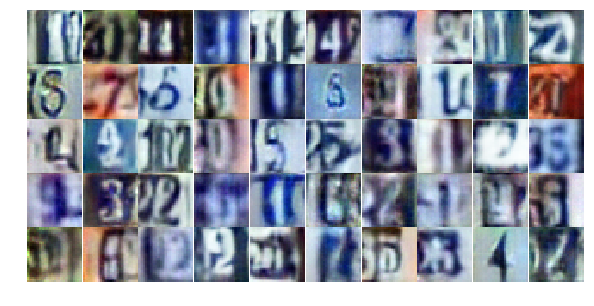

Epoch 14/25... Discriminator Loss: 0.8842... Generator Loss: 0.7578
Epoch 14/25... Discriminator Loss: 1.0132... Generator Loss: 0.7295
Epoch 15/25... Discriminator Loss: 0.5497... Generator Loss: 1.1864
Epoch 15/25... Discriminator Loss: 0.5426... Generator Loss: 1.5482
Epoch 15/25... Discriminator Loss: 0.5053... Generator Loss: 1.3177
Epoch 15/25... Discriminator Loss: 0.7004... Generator Loss: 0.9895
Epoch 15/25... Discriminator Loss: 1.0125... Generator Loss: 0.6201
Epoch 15/25... Discriminator Loss: 0.4882... Generator Loss: 1.4966
Epoch 15/25... Discriminator Loss: 1.7880... Generator Loss: 0.2530
Epoch 15/25... Discriminator Loss: 0.6878... Generator Loss: 1.0529


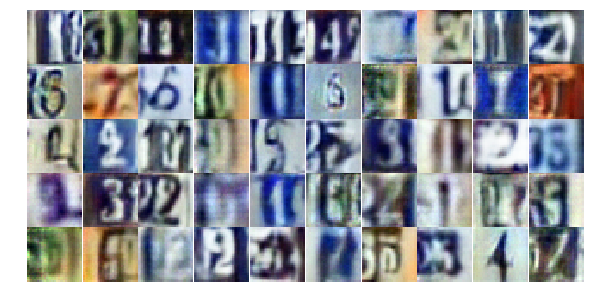

Epoch 15/25... Discriminator Loss: 0.7356... Generator Loss: 1.2488
Epoch 15/25... Discriminator Loss: 0.7263... Generator Loss: 1.9716
Epoch 15/25... Discriminator Loss: 0.9409... Generator Loss: 0.7149
Epoch 15/25... Discriminator Loss: 0.7810... Generator Loss: 0.8575
Epoch 15/25... Discriminator Loss: 0.9763... Generator Loss: 0.7122
Epoch 15/25... Discriminator Loss: 0.5902... Generator Loss: 1.2859
Epoch 15/25... Discriminator Loss: 1.5024... Generator Loss: 0.3919
Epoch 15/25... Discriminator Loss: 0.8564... Generator Loss: 0.8263
Epoch 15/25... Discriminator Loss: 0.4037... Generator Loss: 1.7554
Epoch 15/25... Discriminator Loss: 1.0520... Generator Loss: 0.6086


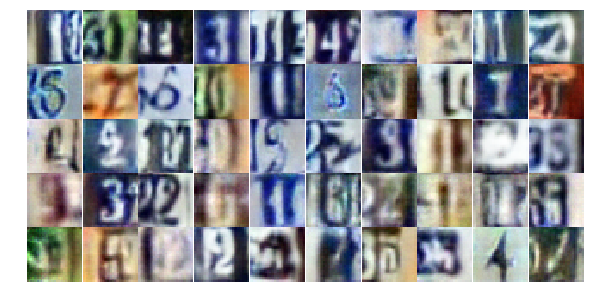

Epoch 15/25... Discriminator Loss: 0.8367... Generator Loss: 0.7714
Epoch 15/25... Discriminator Loss: 0.6674... Generator Loss: 1.0187
Epoch 15/25... Discriminator Loss: 0.4618... Generator Loss: 1.5485
Epoch 15/25... Discriminator Loss: 0.6601... Generator Loss: 0.9954
Epoch 15/25... Discriminator Loss: 0.9747... Generator Loss: 0.6960
Epoch 15/25... Discriminator Loss: 0.7058... Generator Loss: 1.0488
Epoch 15/25... Discriminator Loss: 0.9612... Generator Loss: 0.7057
Epoch 15/25... Discriminator Loss: 0.7673... Generator Loss: 1.0594
Epoch 15/25... Discriminator Loss: 0.5931... Generator Loss: 1.1110
Epoch 15/25... Discriminator Loss: 2.0585... Generator Loss: 0.2275


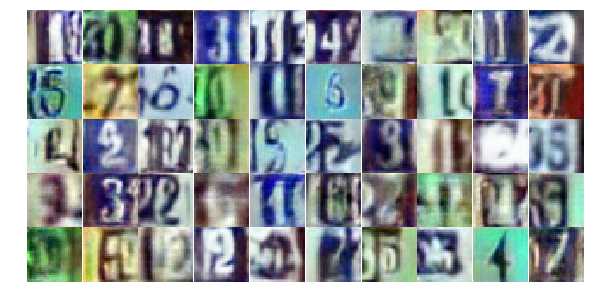

Epoch 15/25... Discriminator Loss: 0.5575... Generator Loss: 1.3933
Epoch 15/25... Discriminator Loss: 0.6678... Generator Loss: 1.6577
Epoch 15/25... Discriminator Loss: 0.5638... Generator Loss: 1.2064
Epoch 15/25... Discriminator Loss: 0.6485... Generator Loss: 1.1620
Epoch 15/25... Discriminator Loss: 0.6379... Generator Loss: 1.1063
Epoch 15/25... Discriminator Loss: 1.6318... Generator Loss: 3.3177
Epoch 15/25... Discriminator Loss: 0.4256... Generator Loss: 2.1298
Epoch 15/25... Discriminator Loss: 0.7113... Generator Loss: 0.9953
Epoch 15/25... Discriminator Loss: 0.5036... Generator Loss: 1.7241
Epoch 15/25... Discriminator Loss: 0.6617... Generator Loss: 1.1323


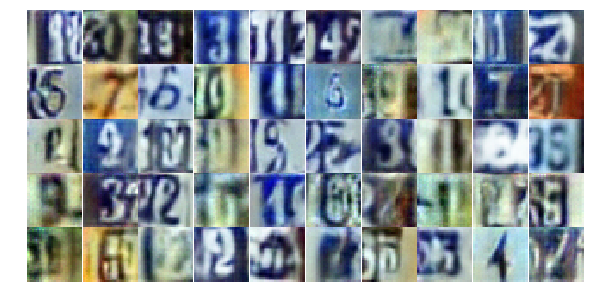

Epoch 15/25... Discriminator Loss: 0.8106... Generator Loss: 0.8764
Epoch 15/25... Discriminator Loss: 1.2732... Generator Loss: 0.4873
Epoch 15/25... Discriminator Loss: 0.9222... Generator Loss: 0.7128
Epoch 15/25... Discriminator Loss: 0.2917... Generator Loss: 1.8691
Epoch 15/25... Discriminator Loss: 0.5387... Generator Loss: 1.2387
Epoch 15/25... Discriminator Loss: 1.6777... Generator Loss: 0.3209
Epoch 15/25... Discriminator Loss: 0.6014... Generator Loss: 1.0892
Epoch 15/25... Discriminator Loss: 0.8723... Generator Loss: 0.7578
Epoch 15/25... Discriminator Loss: 0.7525... Generator Loss: 0.8947
Epoch 15/25... Discriminator Loss: 0.8714... Generator Loss: 1.9653


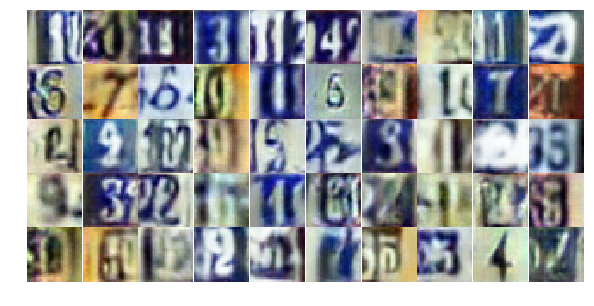

Epoch 15/25... Discriminator Loss: 0.4755... Generator Loss: 1.2396
Epoch 15/25... Discriminator Loss: 0.7078... Generator Loss: 1.1976
Epoch 15/25... Discriminator Loss: 0.4233... Generator Loss: 1.4548
Epoch 15/25... Discriminator Loss: 0.8457... Generator Loss: 1.3014
Epoch 15/25... Discriminator Loss: 0.6490... Generator Loss: 1.0290
Epoch 15/25... Discriminator Loss: 1.3346... Generator Loss: 0.4691
Epoch 15/25... Discriminator Loss: 0.7391... Generator Loss: 1.2263
Epoch 15/25... Discriminator Loss: 0.5268... Generator Loss: 1.4025
Epoch 15/25... Discriminator Loss: 1.4968... Generator Loss: 0.3671
Epoch 16/25... Discriminator Loss: 1.3112... Generator Loss: 0.4978


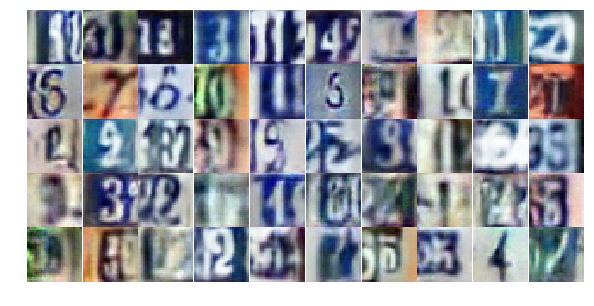

Epoch 16/25... Discriminator Loss: 0.4797... Generator Loss: 1.4226
Epoch 16/25... Discriminator Loss: 0.6620... Generator Loss: 1.1388
Epoch 16/25... Discriminator Loss: 1.1507... Generator Loss: 0.5268
Epoch 16/25... Discriminator Loss: 0.6446... Generator Loss: 1.3986
Epoch 16/25... Discriminator Loss: 0.5325... Generator Loss: 1.9629
Epoch 16/25... Discriminator Loss: 1.5571... Generator Loss: 3.4705
Epoch 16/25... Discriminator Loss: 1.8955... Generator Loss: 0.2600
Epoch 16/25... Discriminator Loss: 0.7064... Generator Loss: 1.0678
Epoch 16/25... Discriminator Loss: 0.5969... Generator Loss: 1.1182
Epoch 16/25... Discriminator Loss: 0.7310... Generator Loss: 0.9005


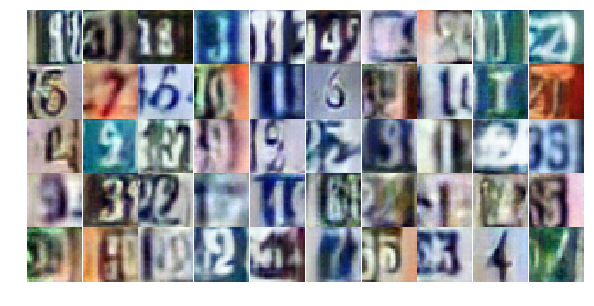

Epoch 16/25... Discriminator Loss: 1.1189... Generator Loss: 0.5594
Epoch 16/25... Discriminator Loss: 0.5165... Generator Loss: 1.3753
Epoch 16/25... Discriminator Loss: 0.5688... Generator Loss: 1.2494
Epoch 16/25... Discriminator Loss: 1.2005... Generator Loss: 0.4956
Epoch 16/25... Discriminator Loss: 0.6348... Generator Loss: 1.1092
Epoch 16/25... Discriminator Loss: 0.6520... Generator Loss: 1.4399
Epoch 16/25... Discriminator Loss: 1.4624... Generator Loss: 0.5056
Epoch 16/25... Discriminator Loss: 0.5175... Generator Loss: 1.3734
Epoch 16/25... Discriminator Loss: 0.4994... Generator Loss: 1.5315
Epoch 16/25... Discriminator Loss: 0.6969... Generator Loss: 0.9016


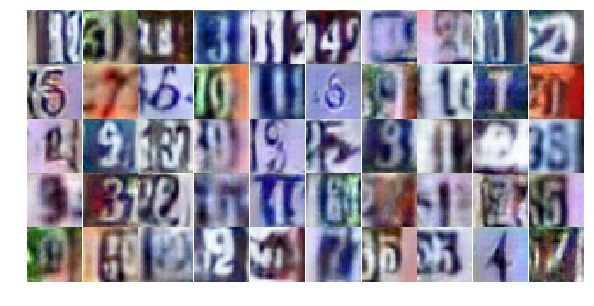

Epoch 16/25... Discriminator Loss: 0.5890... Generator Loss: 1.1854
Epoch 16/25... Discriminator Loss: 0.6309... Generator Loss: 1.2103
Epoch 16/25... Discriminator Loss: 0.8357... Generator Loss: 0.8395
Epoch 16/25... Discriminator Loss: 1.1313... Generator Loss: 0.5726
Epoch 16/25... Discriminator Loss: 1.0381... Generator Loss: 0.6255
Epoch 16/25... Discriminator Loss: 0.9337... Generator Loss: 0.7080
Epoch 16/25... Discriminator Loss: 0.6569... Generator Loss: 1.0510
Epoch 16/25... Discriminator Loss: 0.5599... Generator Loss: 1.2727
Epoch 16/25... Discriminator Loss: 0.6379... Generator Loss: 1.1598
Epoch 16/25... Discriminator Loss: 0.5918... Generator Loss: 1.2113


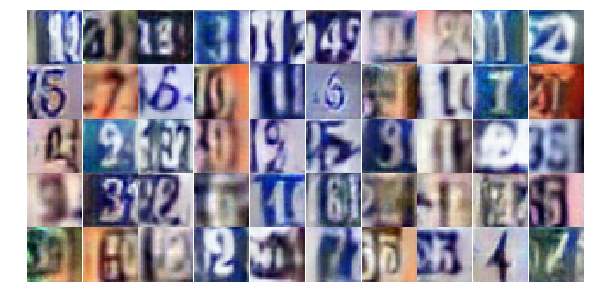

Epoch 16/25... Discriminator Loss: 0.5838... Generator Loss: 1.1368
Epoch 16/25... Discriminator Loss: 0.8157... Generator Loss: 0.8413
Epoch 16/25... Discriminator Loss: 0.6177... Generator Loss: 1.8074
Epoch 16/25... Discriminator Loss: 1.7562... Generator Loss: 1.1699
Epoch 16/25... Discriminator Loss: 1.3667... Generator Loss: 2.7774
Epoch 16/25... Discriminator Loss: 0.9566... Generator Loss: 1.6532
Epoch 16/25... Discriminator Loss: 0.7817... Generator Loss: 0.8928
Epoch 16/25... Discriminator Loss: 1.0788... Generator Loss: 0.5824
Epoch 16/25... Discriminator Loss: 0.7628... Generator Loss: 0.8867
Epoch 16/25... Discriminator Loss: 0.5449... Generator Loss: 1.8844


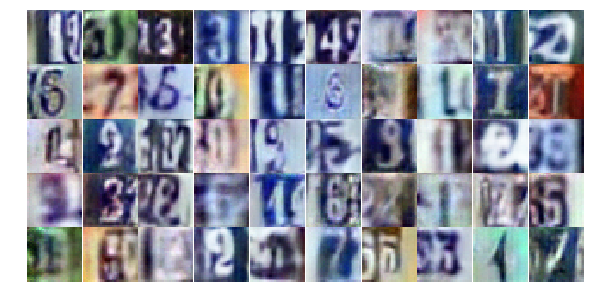

Epoch 16/25... Discriminator Loss: 0.5437... Generator Loss: 1.6714
Epoch 16/25... Discriminator Loss: 0.6070... Generator Loss: 1.1521
Epoch 16/25... Discriminator Loss: 0.7378... Generator Loss: 0.9940
Epoch 16/25... Discriminator Loss: 0.9089... Generator Loss: 1.1262
Epoch 16/25... Discriminator Loss: 0.6169... Generator Loss: 1.4228
Epoch 16/25... Discriminator Loss: 0.7861... Generator Loss: 0.9644
Epoch 16/25... Discriminator Loss: 0.4778... Generator Loss: 1.5160
Epoch 16/25... Discriminator Loss: 0.6007... Generator Loss: 1.3753
Epoch 16/25... Discriminator Loss: 0.4825... Generator Loss: 1.3263
Epoch 16/25... Discriminator Loss: 0.7045... Generator Loss: 0.8978


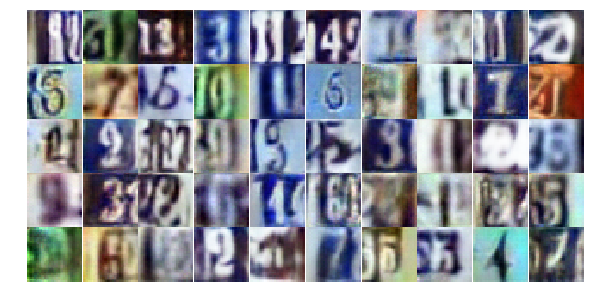

Epoch 16/25... Discriminator Loss: 1.1740... Generator Loss: 0.5154
Epoch 16/25... Discriminator Loss: 0.7632... Generator Loss: 0.8771
Epoch 16/25... Discriminator Loss: 1.4499... Generator Loss: 0.4450
Epoch 16/25... Discriminator Loss: 0.4400... Generator Loss: 2.1744
Epoch 16/25... Discriminator Loss: 0.4779... Generator Loss: 1.6868
Epoch 16/25... Discriminator Loss: 0.7804... Generator Loss: 0.8791
Epoch 17/25... Discriminator Loss: 0.7031... Generator Loss: 1.0186
Epoch 17/25... Discriminator Loss: 0.9127... Generator Loss: 0.7199
Epoch 17/25... Discriminator Loss: 0.7456... Generator Loss: 1.0729
Epoch 17/25... Discriminator Loss: 0.7434... Generator Loss: 0.8928


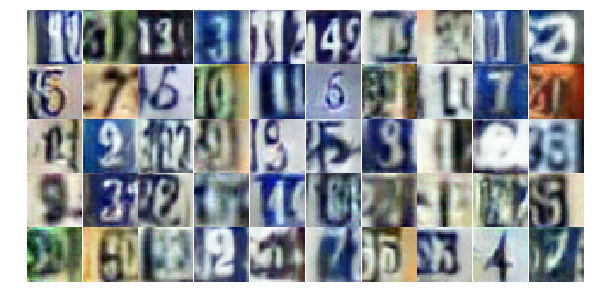

Epoch 17/25... Discriminator Loss: 0.5349... Generator Loss: 1.1900
Epoch 17/25... Discriminator Loss: 0.4710... Generator Loss: 1.3390
Epoch 17/25... Discriminator Loss: 0.7115... Generator Loss: 1.1268
Epoch 17/25... Discriminator Loss: 0.5195... Generator Loss: 1.3489
Epoch 17/25... Discriminator Loss: 1.1296... Generator Loss: 0.5661
Epoch 17/25... Discriminator Loss: 1.0512... Generator Loss: 0.6127
Epoch 17/25... Discriminator Loss: 0.6835... Generator Loss: 1.1524
Epoch 17/25... Discriminator Loss: 0.3855... Generator Loss: 1.4913
Epoch 17/25... Discriminator Loss: 0.5778... Generator Loss: 1.1391
Epoch 17/25... Discriminator Loss: 0.7900... Generator Loss: 2.7303


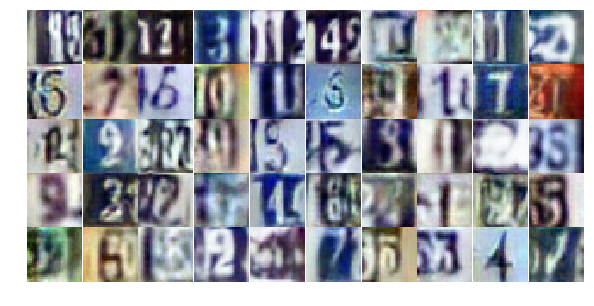

Epoch 17/25... Discriminator Loss: 0.8031... Generator Loss: 1.1459
Epoch 17/25... Discriminator Loss: 0.7441... Generator Loss: 1.7554
Epoch 17/25... Discriminator Loss: 0.6132... Generator Loss: 1.3364
Epoch 17/25... Discriminator Loss: 0.7455... Generator Loss: 0.9759
Epoch 17/25... Discriminator Loss: 0.5130... Generator Loss: 1.5809
Epoch 17/25... Discriminator Loss: 0.8934... Generator Loss: 0.7968
Epoch 17/25... Discriminator Loss: 0.6341... Generator Loss: 1.7002
Epoch 17/25... Discriminator Loss: 0.6407... Generator Loss: 1.1441
Epoch 17/25... Discriminator Loss: 0.8210... Generator Loss: 0.8554
Epoch 17/25... Discriminator Loss: 0.6559... Generator Loss: 1.0220


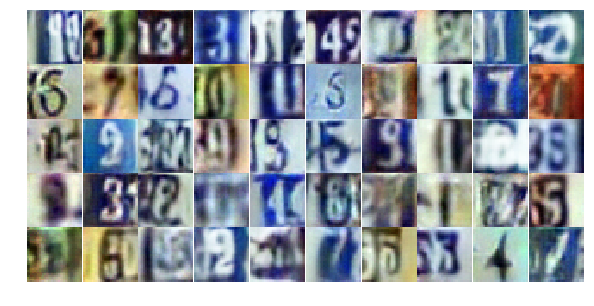

Epoch 17/25... Discriminator Loss: 1.4250... Generator Loss: 0.3914
Epoch 17/25... Discriminator Loss: 0.3357... Generator Loss: 2.0172
Epoch 17/25... Discriminator Loss: 0.4569... Generator Loss: 1.6011
Epoch 17/25... Discriminator Loss: 1.1493... Generator Loss: 0.6121
Epoch 17/25... Discriminator Loss: 1.1846... Generator Loss: 0.4957
Epoch 17/25... Discriminator Loss: 0.4973... Generator Loss: 1.3584
Epoch 17/25... Discriminator Loss: 0.7205... Generator Loss: 0.9726
Epoch 17/25... Discriminator Loss: 0.8924... Generator Loss: 0.7066
Epoch 17/25... Discriminator Loss: 0.9599... Generator Loss: 0.6715
Epoch 17/25... Discriminator Loss: 0.4888... Generator Loss: 1.3634


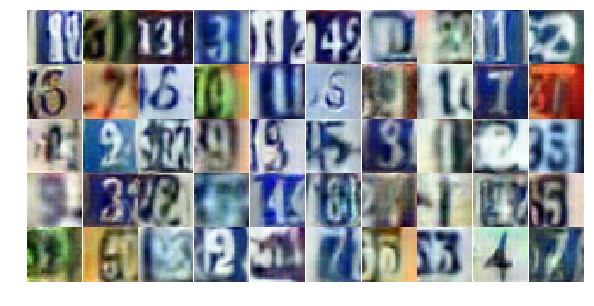

Epoch 17/25... Discriminator Loss: 0.4936... Generator Loss: 1.7120
Epoch 17/25... Discriminator Loss: 1.5011... Generator Loss: 0.3748
Epoch 17/25... Discriminator Loss: 0.7131... Generator Loss: 0.9872
Epoch 17/25... Discriminator Loss: 0.9501... Generator Loss: 1.6740
Epoch 17/25... Discriminator Loss: 0.5698... Generator Loss: 1.2201
Epoch 17/25... Discriminator Loss: 0.6771... Generator Loss: 1.1226
Epoch 17/25... Discriminator Loss: 1.0525... Generator Loss: 0.6529
Epoch 17/25... Discriminator Loss: 0.4943... Generator Loss: 1.5073
Epoch 17/25... Discriminator Loss: 0.3314... Generator Loss: 1.8927
Epoch 17/25... Discriminator Loss: 0.7652... Generator Loss: 1.1336


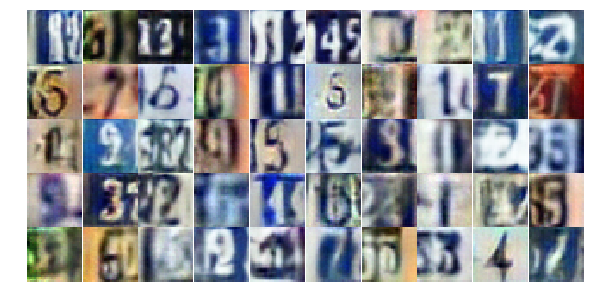

Epoch 17/25... Discriminator Loss: 1.5823... Generator Loss: 3.6305
Epoch 17/25... Discriminator Loss: 0.4459... Generator Loss: 1.8348
Epoch 17/25... Discriminator Loss: 0.7341... Generator Loss: 1.4023
Epoch 17/25... Discriminator Loss: 0.4903... Generator Loss: 1.4967
Epoch 17/25... Discriminator Loss: 0.7789... Generator Loss: 0.8497
Epoch 17/25... Discriminator Loss: 0.6912... Generator Loss: 1.2079
Epoch 17/25... Discriminator Loss: 1.2920... Generator Loss: 0.4323
Epoch 17/25... Discriminator Loss: 0.4866... Generator Loss: 1.4481
Epoch 17/25... Discriminator Loss: 0.5640... Generator Loss: 1.2429
Epoch 17/25... Discriminator Loss: 1.7773... Generator Loss: 0.2549


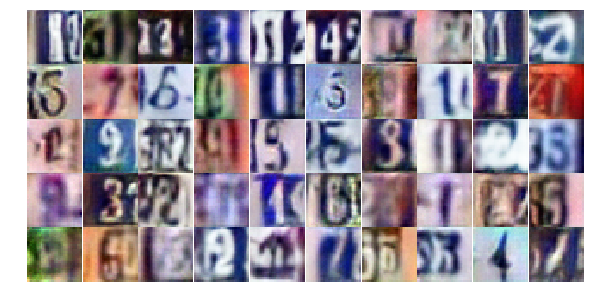

Epoch 17/25... Discriminator Loss: 0.7802... Generator Loss: 1.7826
Epoch 17/25... Discriminator Loss: 0.7943... Generator Loss: 1.0028
Epoch 17/25... Discriminator Loss: 0.5707... Generator Loss: 1.1930
Epoch 17/25... Discriminator Loss: 0.7741... Generator Loss: 0.9283
Epoch 18/25... Discriminator Loss: 0.8296... Generator Loss: 0.7981
Epoch 18/25... Discriminator Loss: 1.6300... Generator Loss: 0.3161
Epoch 18/25... Discriminator Loss: 1.0327... Generator Loss: 0.6055
Epoch 18/25... Discriminator Loss: 0.7759... Generator Loss: 0.8531
Epoch 18/25... Discriminator Loss: 1.1550... Generator Loss: 0.5162
Epoch 18/25... Discriminator Loss: 0.7609... Generator Loss: 1.0582


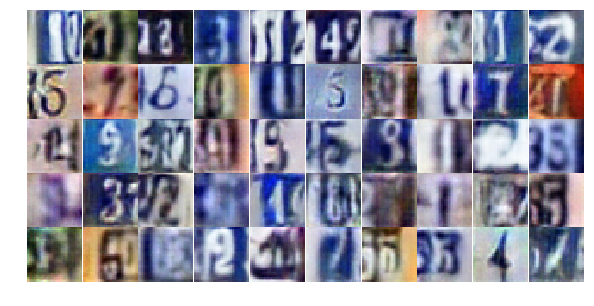

Epoch 18/25... Discriminator Loss: 5.2864... Generator Loss: 6.1467
Epoch 18/25... Discriminator Loss: 0.8693... Generator Loss: 0.8965
Epoch 18/25... Discriminator Loss: 1.0328... Generator Loss: 0.6356
Epoch 18/25... Discriminator Loss: 0.4922... Generator Loss: 1.5450
Epoch 18/25... Discriminator Loss: 0.7091... Generator Loss: 0.9879
Epoch 18/25... Discriminator Loss: 0.9585... Generator Loss: 0.7099
Epoch 18/25... Discriminator Loss: 0.6740... Generator Loss: 0.9586
Epoch 18/25... Discriminator Loss: 1.0049... Generator Loss: 0.6800
Epoch 18/25... Discriminator Loss: 0.6162... Generator Loss: 1.0585
Epoch 18/25... Discriminator Loss: 0.3818... Generator Loss: 1.6328


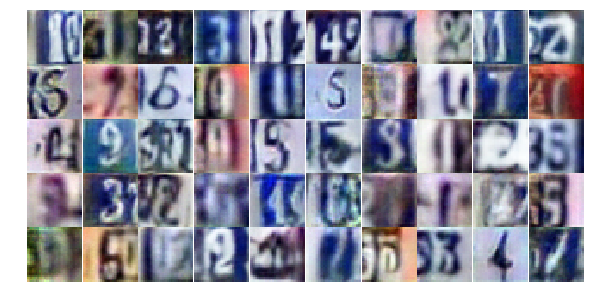

Epoch 18/25... Discriminator Loss: 0.7401... Generator Loss: 0.9899
Epoch 18/25... Discriminator Loss: 0.8101... Generator Loss: 0.8632
Epoch 18/25... Discriminator Loss: 0.9531... Generator Loss: 0.7770
Epoch 18/25... Discriminator Loss: 0.4156... Generator Loss: 1.5651
Epoch 18/25... Discriminator Loss: 0.9506... Generator Loss: 0.7044
Epoch 18/25... Discriminator Loss: 1.3475... Generator Loss: 0.4328
Epoch 18/25... Discriminator Loss: 0.8083... Generator Loss: 0.8832
Epoch 18/25... Discriminator Loss: 0.8047... Generator Loss: 0.8618
Epoch 18/25... Discriminator Loss: 0.7723... Generator Loss: 0.9315
Epoch 18/25... Discriminator Loss: 0.5262... Generator Loss: 1.2514


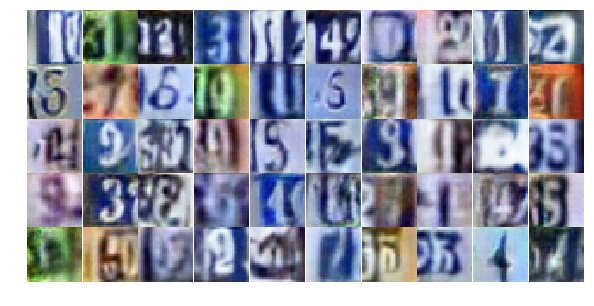

Epoch 18/25... Discriminator Loss: 0.4734... Generator Loss: 1.3809
Epoch 18/25... Discriminator Loss: 0.8825... Generator Loss: 0.7389
Epoch 18/25... Discriminator Loss: 0.7417... Generator Loss: 0.9127
Epoch 18/25... Discriminator Loss: 0.5720... Generator Loss: 1.5454
Epoch 18/25... Discriminator Loss: 1.0690... Generator Loss: 0.6748
Epoch 18/25... Discriminator Loss: 0.6241... Generator Loss: 1.2002
Epoch 18/25... Discriminator Loss: 0.6537... Generator Loss: 1.0321
Epoch 18/25... Discriminator Loss: 0.5503... Generator Loss: 1.2468
Epoch 18/25... Discriminator Loss: 0.6591... Generator Loss: 1.0164
Epoch 18/25... Discriminator Loss: 0.5672... Generator Loss: 1.3601


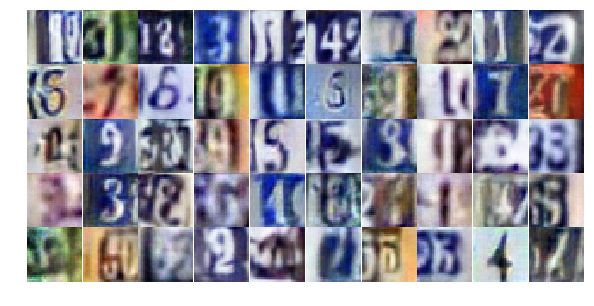

Epoch 18/25... Discriminator Loss: 0.5920... Generator Loss: 1.3462
Epoch 18/25... Discriminator Loss: 0.7480... Generator Loss: 0.9078
Epoch 18/25... Discriminator Loss: 0.6644... Generator Loss: 1.0202
Epoch 18/25... Discriminator Loss: 0.8602... Generator Loss: 0.7115
Epoch 18/25... Discriminator Loss: 1.0221... Generator Loss: 0.7250
Epoch 18/25... Discriminator Loss: 0.5526... Generator Loss: 1.1401
Epoch 18/25... Discriminator Loss: 0.7120... Generator Loss: 0.9575
Epoch 18/25... Discriminator Loss: 1.5332... Generator Loss: 3.0542
Epoch 18/25... Discriminator Loss: 0.6807... Generator Loss: 1.0339
Epoch 18/25... Discriminator Loss: 0.4849... Generator Loss: 1.3175


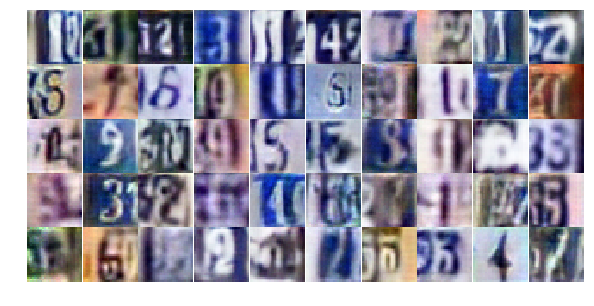

Epoch 18/25... Discriminator Loss: 0.6917... Generator Loss: 0.9646
Epoch 18/25... Discriminator Loss: 1.1226... Generator Loss: 0.6072
Epoch 18/25... Discriminator Loss: 0.9229... Generator Loss: 0.7217
Epoch 18/25... Discriminator Loss: 1.0139... Generator Loss: 0.6632
Epoch 18/25... Discriminator Loss: 0.6806... Generator Loss: 0.9590
Epoch 18/25... Discriminator Loss: 1.5695... Generator Loss: 0.3515
Epoch 18/25... Discriminator Loss: 0.6124... Generator Loss: 1.6806
Epoch 18/25... Discriminator Loss: 0.4532... Generator Loss: 1.7179
Epoch 18/25... Discriminator Loss: 0.6487... Generator Loss: 1.3292
Epoch 18/25... Discriminator Loss: 1.5478... Generator Loss: 0.3524


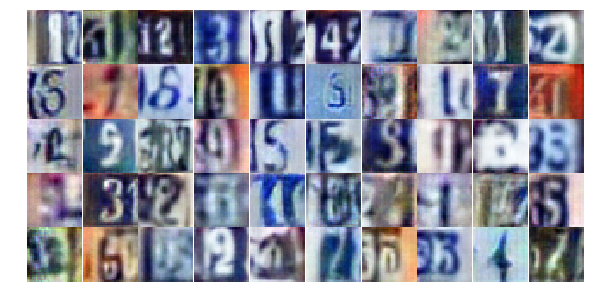

Epoch 18/25... Discriminator Loss: 0.6927... Generator Loss: 2.3052
Epoch 19/25... Discriminator Loss: 0.8670... Generator Loss: 0.7792
Epoch 19/25... Discriminator Loss: 1.4023... Generator Loss: 0.4588
Epoch 19/25... Discriminator Loss: 1.0930... Generator Loss: 0.5731
Epoch 19/25... Discriminator Loss: 0.6978... Generator Loss: 1.0181
Epoch 19/25... Discriminator Loss: 0.8560... Generator Loss: 0.9104
Epoch 19/25... Discriminator Loss: 0.6078... Generator Loss: 1.1056
Epoch 19/25... Discriminator Loss: 0.6177... Generator Loss: 1.4518
Epoch 19/25... Discriminator Loss: 0.7845... Generator Loss: 2.0507
Epoch 19/25... Discriminator Loss: 0.9724... Generator Loss: 0.6971


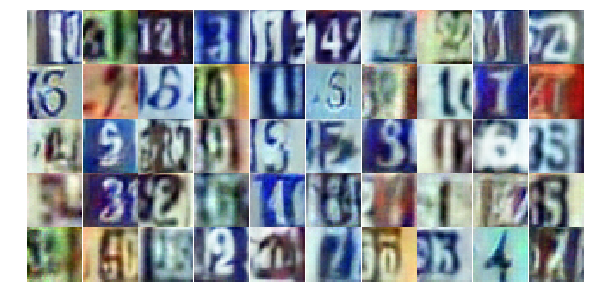

Epoch 19/25... Discriminator Loss: 0.6911... Generator Loss: 0.9517
Epoch 19/25... Discriminator Loss: 0.7672... Generator Loss: 1.9946
Epoch 19/25... Discriminator Loss: 0.5833... Generator Loss: 1.2869
Epoch 19/25... Discriminator Loss: 1.3856... Generator Loss: 0.4226
Epoch 19/25... Discriminator Loss: 0.9779... Generator Loss: 0.6849
Epoch 19/25... Discriminator Loss: 0.6682... Generator Loss: 1.4220
Epoch 19/25... Discriminator Loss: 4.0449... Generator Loss: 5.8060
Epoch 19/25... Discriminator Loss: 0.7082... Generator Loss: 1.2856
Epoch 19/25... Discriminator Loss: 0.9695... Generator Loss: 1.7352
Epoch 19/25... Discriminator Loss: 1.1984... Generator Loss: 0.5856


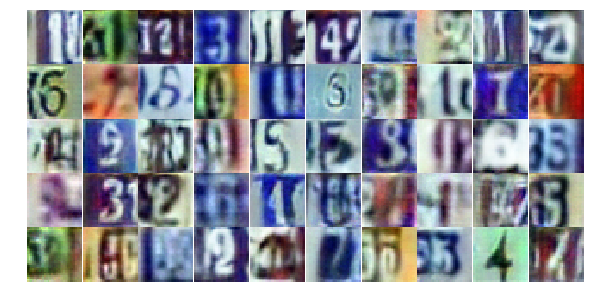

Epoch 19/25... Discriminator Loss: 0.7124... Generator Loss: 1.0264
Epoch 19/25... Discriminator Loss: 1.0337... Generator Loss: 0.7460
Epoch 19/25... Discriminator Loss: 1.3380... Generator Loss: 0.4270
Epoch 19/25... Discriminator Loss: 0.8874... Generator Loss: 0.9260
Epoch 19/25... Discriminator Loss: 0.7091... Generator Loss: 1.0076
Epoch 19/25... Discriminator Loss: 0.8722... Generator Loss: 0.7762
Epoch 19/25... Discriminator Loss: 0.6408... Generator Loss: 1.3036
Epoch 19/25... Discriminator Loss: 0.7628... Generator Loss: 0.8482
Epoch 19/25... Discriminator Loss: 0.9340... Generator Loss: 0.7010
Epoch 19/25... Discriminator Loss: 1.0787... Generator Loss: 0.5887


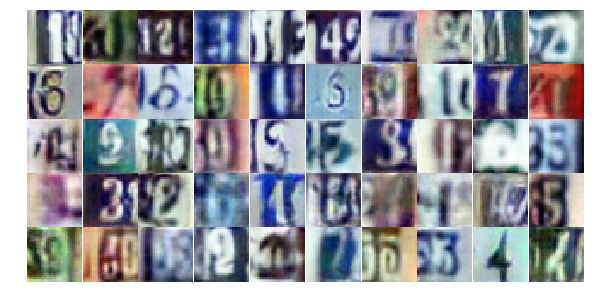

Epoch 19/25... Discriminator Loss: 0.9809... Generator Loss: 0.7390
Epoch 19/25... Discriminator Loss: 0.9813... Generator Loss: 0.6624
Epoch 19/25... Discriminator Loss: 0.9837... Generator Loss: 0.6554
Epoch 19/25... Discriminator Loss: 0.5446... Generator Loss: 1.1347
Epoch 19/25... Discriminator Loss: 0.7411... Generator Loss: 0.9920
Epoch 19/25... Discriminator Loss: 1.0897... Generator Loss: 0.6017
Epoch 19/25... Discriminator Loss: 0.8817... Generator Loss: 1.5243
Epoch 19/25... Discriminator Loss: 0.5345... Generator Loss: 2.7708
Epoch 19/25... Discriminator Loss: 1.1983... Generator Loss: 0.5321
Epoch 19/25... Discriminator Loss: 0.6781... Generator Loss: 1.0683


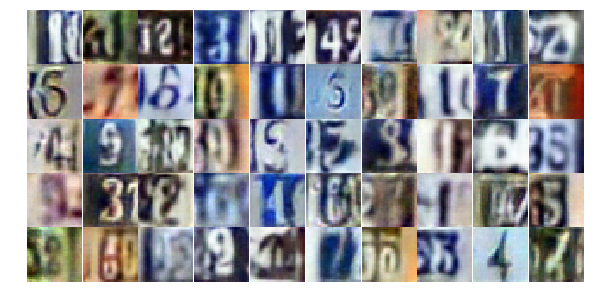

Epoch 19/25... Discriminator Loss: 0.7078... Generator Loss: 1.0089
Epoch 19/25... Discriminator Loss: 0.6783... Generator Loss: 1.2680
Epoch 19/25... Discriminator Loss: 0.7935... Generator Loss: 0.8760
Epoch 19/25... Discriminator Loss: 1.0680... Generator Loss: 0.6094
Epoch 19/25... Discriminator Loss: 0.7728... Generator Loss: 0.8740
Epoch 19/25... Discriminator Loss: 0.5055... Generator Loss: 1.5807
Epoch 19/25... Discriminator Loss: 0.7601... Generator Loss: 0.9694
Epoch 19/25... Discriminator Loss: 0.4142... Generator Loss: 1.6839
Epoch 19/25... Discriminator Loss: 0.5734... Generator Loss: 1.3299
Epoch 19/25... Discriminator Loss: 0.7334... Generator Loss: 1.1477


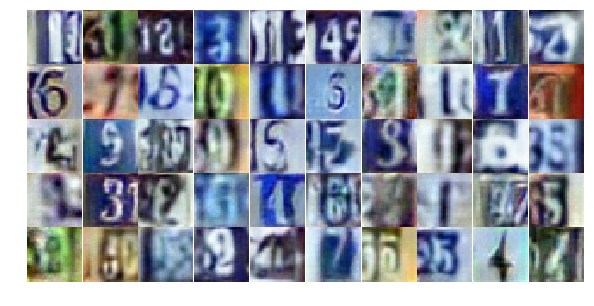

Epoch 19/25... Discriminator Loss: 0.8826... Generator Loss: 0.7493
Epoch 19/25... Discriminator Loss: 0.9377... Generator Loss: 0.7021
Epoch 19/25... Discriminator Loss: 0.6756... Generator Loss: 2.3911
Epoch 19/25... Discriminator Loss: 1.1433... Generator Loss: 0.6226
Epoch 19/25... Discriminator Loss: 0.7536... Generator Loss: 1.4925
Epoch 19/25... Discriminator Loss: 0.8011... Generator Loss: 0.9743
Epoch 19/25... Discriminator Loss: 1.9089... Generator Loss: 0.3339
Epoch 19/25... Discriminator Loss: 1.2946... Generator Loss: 0.8404
Epoch 20/25... Discriminator Loss: 0.7096... Generator Loss: 1.1764
Epoch 20/25... Discriminator Loss: 0.7567... Generator Loss: 1.0382


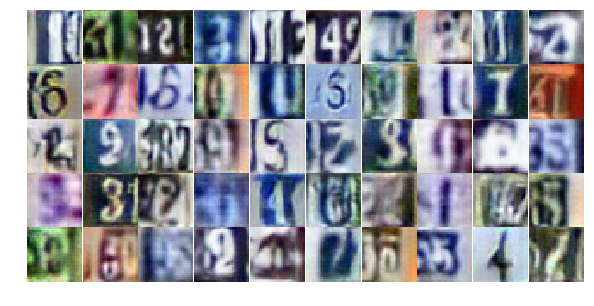

Epoch 20/25... Discriminator Loss: 0.5683... Generator Loss: 1.1890
Epoch 20/25... Discriminator Loss: 0.9790... Generator Loss: 0.6940
Epoch 20/25... Discriminator Loss: 1.4133... Generator Loss: 0.4529
Epoch 20/25... Discriminator Loss: 1.3507... Generator Loss: 0.5118
Epoch 20/25... Discriminator Loss: 0.5653... Generator Loss: 1.2742
Epoch 20/25... Discriminator Loss: 0.5768... Generator Loss: 1.0910
Epoch 20/25... Discriminator Loss: 0.7422... Generator Loss: 1.3557
Epoch 20/25... Discriminator Loss: 0.7620... Generator Loss: 0.9876
Epoch 20/25... Discriminator Loss: 0.9525... Generator Loss: 0.7247
Epoch 20/25... Discriminator Loss: 1.2563... Generator Loss: 0.4789


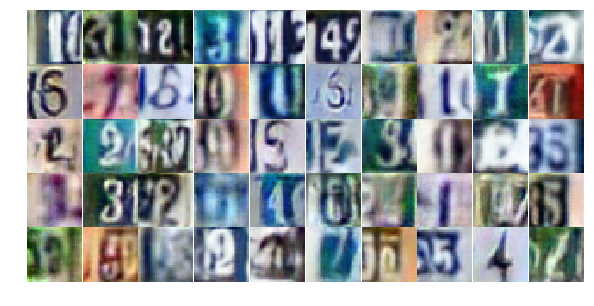

Epoch 20/25... Discriminator Loss: 1.1737... Generator Loss: 0.5295
Epoch 20/25... Discriminator Loss: 0.9482... Generator Loss: 0.7404
Epoch 20/25... Discriminator Loss: 0.6962... Generator Loss: 1.1514
Epoch 20/25... Discriminator Loss: 0.7602... Generator Loss: 0.9431
Epoch 20/25... Discriminator Loss: 0.9214... Generator Loss: 0.7622
Epoch 20/25... Discriminator Loss: 1.0518... Generator Loss: 0.5855
Epoch 20/25... Discriminator Loss: 0.9310... Generator Loss: 0.7718
Epoch 20/25... Discriminator Loss: 0.6860... Generator Loss: 1.0160
Epoch 20/25... Discriminator Loss: 0.4690... Generator Loss: 1.4811
Epoch 20/25... Discriminator Loss: 1.3031... Generator Loss: 0.4347


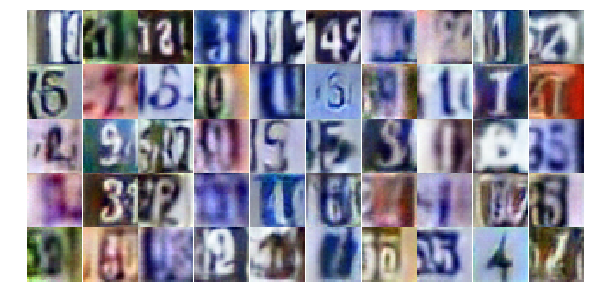

Epoch 20/25... Discriminator Loss: 0.5656... Generator Loss: 1.3385
Epoch 20/25... Discriminator Loss: 0.5233... Generator Loss: 1.2284
Epoch 20/25... Discriminator Loss: 0.3053... Generator Loss: 2.2597
Epoch 20/25... Discriminator Loss: 1.5918... Generator Loss: 0.3532
Epoch 20/25... Discriminator Loss: 1.3860... Generator Loss: 0.4211
Epoch 20/25... Discriminator Loss: 0.6931... Generator Loss: 2.5257
Epoch 20/25... Discriminator Loss: 0.7561... Generator Loss: 0.9558
Epoch 20/25... Discriminator Loss: 1.7174... Generator Loss: 0.3643
Epoch 20/25... Discriminator Loss: 0.7249... Generator Loss: 1.4418
Epoch 20/25... Discriminator Loss: 0.6014... Generator Loss: 1.0310


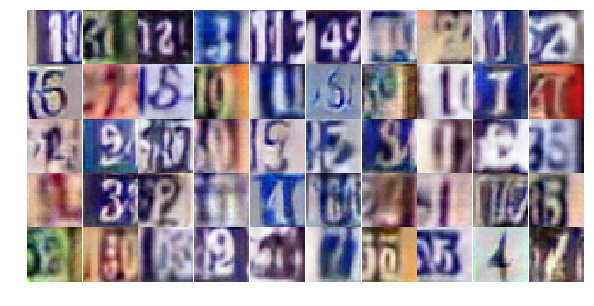

Epoch 20/25... Discriminator Loss: 1.0054... Generator Loss: 0.6528
Epoch 20/25... Discriminator Loss: 0.9835... Generator Loss: 0.7171
Epoch 20/25... Discriminator Loss: 1.0369... Generator Loss: 1.3308
Epoch 20/25... Discriminator Loss: 0.7793... Generator Loss: 1.8838
Epoch 20/25... Discriminator Loss: 1.0303... Generator Loss: 0.6207
Epoch 20/25... Discriminator Loss: 0.5717... Generator Loss: 1.4940
Epoch 20/25... Discriminator Loss: 0.7255... Generator Loss: 1.0824
Epoch 20/25... Discriminator Loss: 0.7058... Generator Loss: 1.0328
Epoch 20/25... Discriminator Loss: 0.7044... Generator Loss: 0.9716
Epoch 20/25... Discriminator Loss: 1.1375... Generator Loss: 0.5327


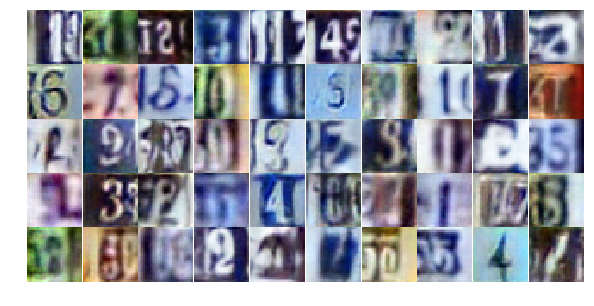

Epoch 20/25... Discriminator Loss: 0.6496... Generator Loss: 1.1206
Epoch 20/25... Discriminator Loss: 0.7420... Generator Loss: 1.0827
Epoch 20/25... Discriminator Loss: 1.0542... Generator Loss: 0.7482
Epoch 20/25... Discriminator Loss: 0.6887... Generator Loss: 1.0944
Epoch 20/25... Discriminator Loss: 0.8376... Generator Loss: 0.8012
Epoch 20/25... Discriminator Loss: 1.2541... Generator Loss: 0.5082
Epoch 20/25... Discriminator Loss: 1.0072... Generator Loss: 0.6702
Epoch 20/25... Discriminator Loss: 0.5082... Generator Loss: 1.3581
Epoch 20/25... Discriminator Loss: 0.5757... Generator Loss: 1.2956
Epoch 20/25... Discriminator Loss: 0.6613... Generator Loss: 1.1167


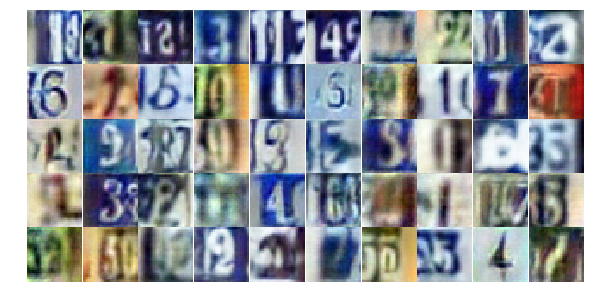

Epoch 20/25... Discriminator Loss: 0.4757... Generator Loss: 3.2657
Epoch 20/25... Discriminator Loss: 1.1949... Generator Loss: 2.7690
Epoch 20/25... Discriminator Loss: 0.4210... Generator Loss: 1.8441
Epoch 20/25... Discriminator Loss: 0.7370... Generator Loss: 1.6830
Epoch 20/25... Discriminator Loss: 0.8108... Generator Loss: 0.8945
Epoch 20/25... Discriminator Loss: 0.8211... Generator Loss: 0.9450
Epoch 21/25... Discriminator Loss: 0.8521... Generator Loss: 0.8215
Epoch 21/25... Discriminator Loss: 1.1523... Generator Loss: 0.5077
Epoch 21/25... Discriminator Loss: 1.4888... Generator Loss: 0.3733
Epoch 21/25... Discriminator Loss: 1.3473... Generator Loss: 0.5463


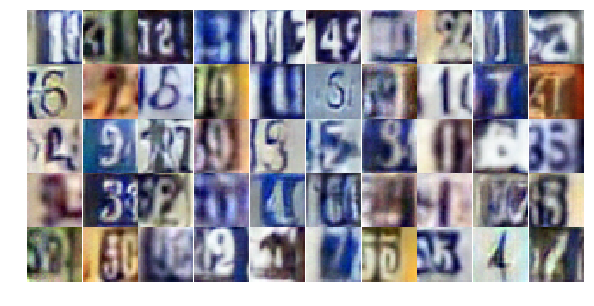

Epoch 21/25... Discriminator Loss: 0.6727... Generator Loss: 2.4096
Epoch 21/25... Discriminator Loss: 1.8961... Generator Loss: 0.2493
Epoch 21/25... Discriminator Loss: 0.5948... Generator Loss: 1.3944
Epoch 21/25... Discriminator Loss: 0.4660... Generator Loss: 1.3219
Epoch 21/25... Discriminator Loss: 0.7366... Generator Loss: 0.9298
Epoch 21/25... Discriminator Loss: 0.5458... Generator Loss: 1.1634
Epoch 21/25... Discriminator Loss: 0.9596... Generator Loss: 0.6889
Epoch 21/25... Discriminator Loss: 1.0579... Generator Loss: 0.6566
Epoch 21/25... Discriminator Loss: 0.8396... Generator Loss: 0.9621
Epoch 21/25... Discriminator Loss: 0.9468... Generator Loss: 0.6696


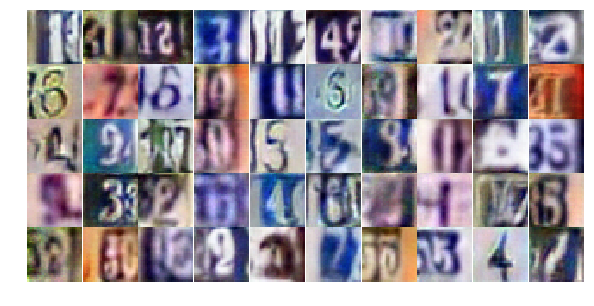

Epoch 21/25... Discriminator Loss: 0.4165... Generator Loss: 2.3808
Epoch 21/25... Discriminator Loss: 2.3772... Generator Loss: 0.1714
Epoch 21/25... Discriminator Loss: 1.2938... Generator Loss: 0.5317
Epoch 21/25... Discriminator Loss: 0.6989... Generator Loss: 1.6627
Epoch 21/25... Discriminator Loss: 0.5644... Generator Loss: 1.2642
Epoch 21/25... Discriminator Loss: 1.2914... Generator Loss: 0.5410
Epoch 21/25... Discriminator Loss: 0.9856... Generator Loss: 0.6645
Epoch 21/25... Discriminator Loss: 0.5270... Generator Loss: 1.4774
Epoch 21/25... Discriminator Loss: 0.6719... Generator Loss: 1.0180
Epoch 21/25... Discriminator Loss: 0.7822... Generator Loss: 0.8739


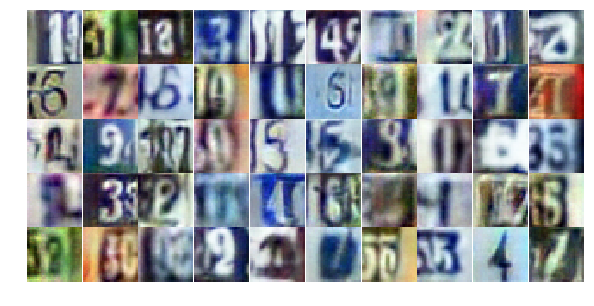

Epoch 21/25... Discriminator Loss: 1.1444... Generator Loss: 0.5834
Epoch 21/25... Discriminator Loss: 0.5407... Generator Loss: 1.1913
Epoch 21/25... Discriminator Loss: 0.8218... Generator Loss: 0.9285
Epoch 21/25... Discriminator Loss: 0.7302... Generator Loss: 1.4663
Epoch 21/25... Discriminator Loss: 0.8786... Generator Loss: 0.7413
Epoch 21/25... Discriminator Loss: 0.9302... Generator Loss: 0.8004
Epoch 21/25... Discriminator Loss: 0.5343... Generator Loss: 1.2761
Epoch 21/25... Discriminator Loss: 1.0881... Generator Loss: 0.5893
Epoch 21/25... Discriminator Loss: 1.0476... Generator Loss: 0.6437
Epoch 21/25... Discriminator Loss: 1.3331... Generator Loss: 0.5466


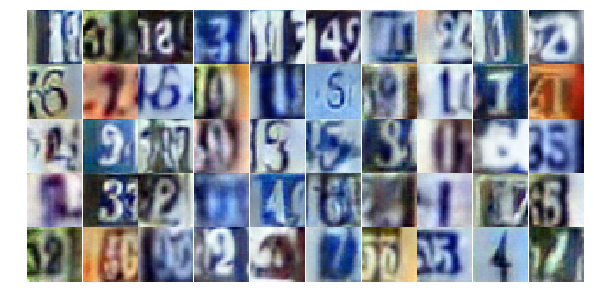

Epoch 21/25... Discriminator Loss: 1.2549... Generator Loss: 0.5251
Epoch 21/25... Discriminator Loss: 0.6288... Generator Loss: 1.1501
Epoch 21/25... Discriminator Loss: 1.3196... Generator Loss: 0.4710
Epoch 21/25... Discriminator Loss: 0.5310... Generator Loss: 1.2953
Epoch 21/25... Discriminator Loss: 0.5919... Generator Loss: 1.1138
Epoch 21/25... Discriminator Loss: 0.6561... Generator Loss: 0.9812
Epoch 21/25... Discriminator Loss: 0.8244... Generator Loss: 0.8629
Epoch 21/25... Discriminator Loss: 2.2258... Generator Loss: 0.1923
Epoch 21/25... Discriminator Loss: 0.8339... Generator Loss: 0.8404
Epoch 21/25... Discriminator Loss: 0.6621... Generator Loss: 1.2357


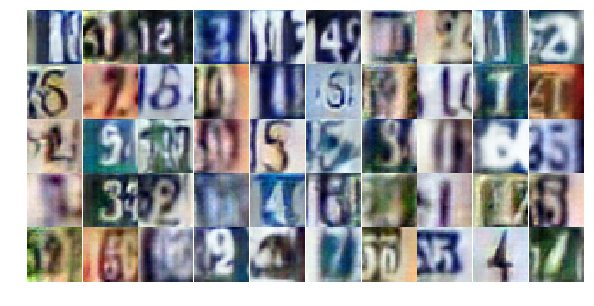

Epoch 21/25... Discriminator Loss: 1.0782... Generator Loss: 0.6848
Epoch 21/25... Discriminator Loss: 1.0741... Generator Loss: 0.6598
Epoch 21/25... Discriminator Loss: 0.6636... Generator Loss: 1.0498
Epoch 21/25... Discriminator Loss: 0.8499... Generator Loss: 0.8369
Epoch 21/25... Discriminator Loss: 0.4056... Generator Loss: 1.6339
Epoch 21/25... Discriminator Loss: 0.8862... Generator Loss: 0.8319
Epoch 21/25... Discriminator Loss: 0.7572... Generator Loss: 1.0243
Epoch 21/25... Discriminator Loss: 1.2890... Generator Loss: 0.4865
Epoch 21/25... Discriminator Loss: 1.0939... Generator Loss: 0.6582
Epoch 21/25... Discriminator Loss: 1.1160... Generator Loss: 0.5857


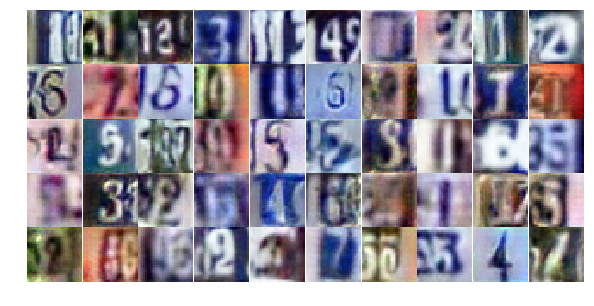

Epoch 21/25... Discriminator Loss: 0.6272... Generator Loss: 1.3602
Epoch 21/25... Discriminator Loss: 1.0236... Generator Loss: 0.6301
Epoch 21/25... Discriminator Loss: 0.4834... Generator Loss: 1.4227
Epoch 22/25... Discriminator Loss: 0.7150... Generator Loss: 1.1231
Epoch 22/25... Discriminator Loss: 0.8614... Generator Loss: 1.0514
Epoch 22/25... Discriminator Loss: 0.6427... Generator Loss: 1.1186
Epoch 22/25... Discriminator Loss: 0.6399... Generator Loss: 1.0344
Epoch 22/25... Discriminator Loss: 0.5011... Generator Loss: 1.2516
Epoch 22/25... Discriminator Loss: 1.2644... Generator Loss: 0.4880
Epoch 22/25... Discriminator Loss: 0.7765... Generator Loss: 1.0587


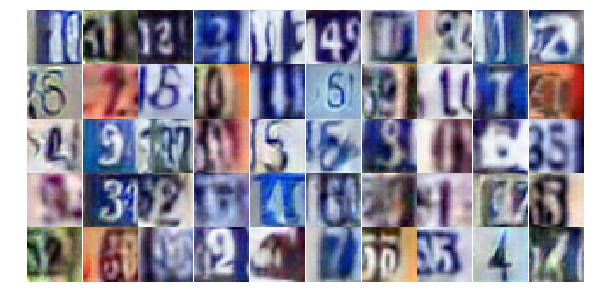

Epoch 22/25... Discriminator Loss: 0.5295... Generator Loss: 1.3851
Epoch 22/25... Discriminator Loss: 0.7224... Generator Loss: 1.0410
Epoch 22/25... Discriminator Loss: 1.7125... Generator Loss: 0.3422
Epoch 22/25... Discriminator Loss: 0.6150... Generator Loss: 1.3342
Epoch 22/25... Discriminator Loss: 0.9245... Generator Loss: 0.9022
Epoch 22/25... Discriminator Loss: 0.9587... Generator Loss: 0.6665
Epoch 22/25... Discriminator Loss: 0.9920... Generator Loss: 0.6519
Epoch 22/25... Discriminator Loss: 0.4917... Generator Loss: 1.5444
Epoch 22/25... Discriminator Loss: 1.2159... Generator Loss: 0.5146
Epoch 22/25... Discriminator Loss: 1.2933... Generator Loss: 0.4894


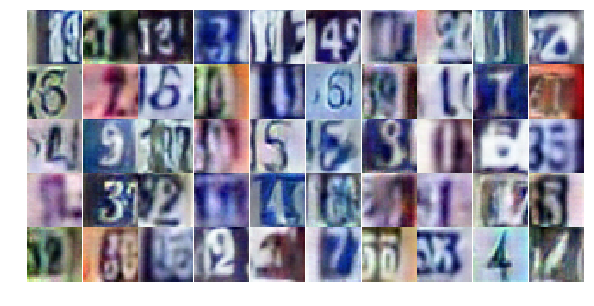

Epoch 22/25... Discriminator Loss: 0.4304... Generator Loss: 1.9659
Epoch 22/25... Discriminator Loss: 0.4609... Generator Loss: 1.3793
Epoch 22/25... Discriminator Loss: 0.9642... Generator Loss: 0.7634
Epoch 22/25... Discriminator Loss: 0.4429... Generator Loss: 1.4138
Epoch 22/25... Discriminator Loss: 0.5074... Generator Loss: 1.3948
Epoch 22/25... Discriminator Loss: 1.2786... Generator Loss: 0.4995
Epoch 22/25... Discriminator Loss: 0.4636... Generator Loss: 1.3152
Epoch 22/25... Discriminator Loss: 0.4245... Generator Loss: 1.5557
Epoch 22/25... Discriminator Loss: 0.4731... Generator Loss: 1.4606
Epoch 22/25... Discriminator Loss: 0.6983... Generator Loss: 0.9725


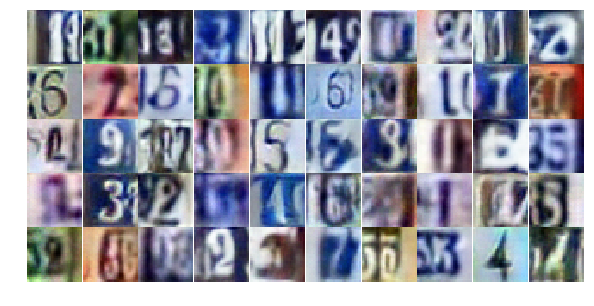

Epoch 22/25... Discriminator Loss: 0.4631... Generator Loss: 1.4039
Epoch 22/25... Discriminator Loss: 0.3352... Generator Loss: 2.0285
Epoch 22/25... Discriminator Loss: 0.5118... Generator Loss: 1.6340
Epoch 22/25... Discriminator Loss: 0.6259... Generator Loss: 1.0597
Epoch 22/25... Discriminator Loss: 0.8353... Generator Loss: 0.7973
Epoch 22/25... Discriminator Loss: 1.0261... Generator Loss: 0.6898
Epoch 22/25... Discriminator Loss: 1.9172... Generator Loss: 0.2898
Epoch 22/25... Discriminator Loss: 0.6596... Generator Loss: 3.4241
Epoch 22/25... Discriminator Loss: 0.9629... Generator Loss: 0.7837
Epoch 22/25... Discriminator Loss: 1.4302... Generator Loss: 0.3872


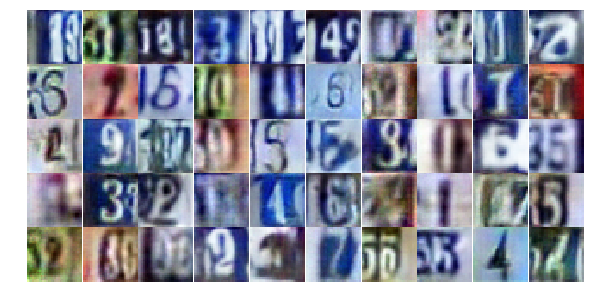

Epoch 22/25... Discriminator Loss: 0.7658... Generator Loss: 0.8943
Epoch 22/25... Discriminator Loss: 0.4926... Generator Loss: 1.4182
Epoch 22/25... Discriminator Loss: 0.3853... Generator Loss: 1.5640
Epoch 22/25... Discriminator Loss: 1.0359... Generator Loss: 0.6641
Epoch 22/25... Discriminator Loss: 0.2712... Generator Loss: 2.2074
Epoch 22/25... Discriminator Loss: 0.4107... Generator Loss: 1.4740
Epoch 22/25... Discriminator Loss: 0.9321... Generator Loss: 0.7780
Epoch 22/25... Discriminator Loss: 0.8405... Generator Loss: 1.6119
Epoch 22/25... Discriminator Loss: 0.8536... Generator Loss: 2.3351
Epoch 22/25... Discriminator Loss: 1.2684... Generator Loss: 0.4981


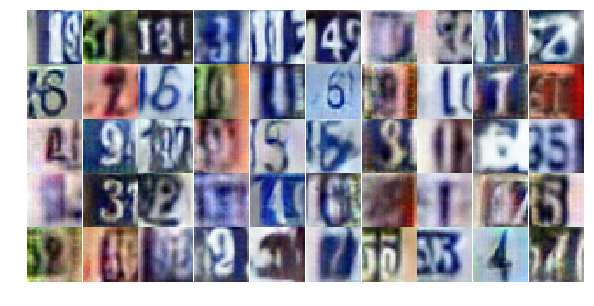

Epoch 22/25... Discriminator Loss: 1.0562... Generator Loss: 0.8580
Epoch 22/25... Discriminator Loss: 0.5561... Generator Loss: 1.3925
Epoch 22/25... Discriminator Loss: 0.8724... Generator Loss: 0.7809
Epoch 22/25... Discriminator Loss: 1.0617... Generator Loss: 0.7085
Epoch 22/25... Discriminator Loss: 1.0616... Generator Loss: 0.7868
Epoch 22/25... Discriminator Loss: 1.0529... Generator Loss: 0.6258
Epoch 22/25... Discriminator Loss: 0.6965... Generator Loss: 1.1252
Epoch 22/25... Discriminator Loss: 0.7012... Generator Loss: 1.0022
Epoch 22/25... Discriminator Loss: 0.8645... Generator Loss: 1.5042
Epoch 22/25... Discriminator Loss: 0.8946... Generator Loss: 0.7909


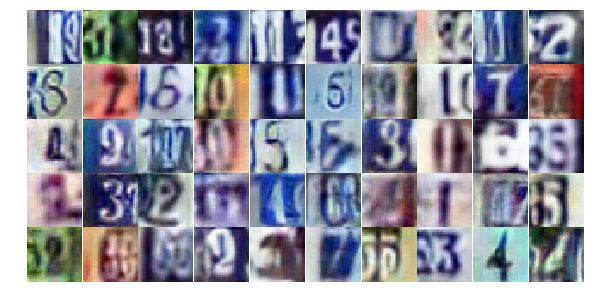

Epoch 23/25... Discriminator Loss: 0.5750... Generator Loss: 1.3841
Epoch 23/25... Discriminator Loss: 0.5192... Generator Loss: 1.2272
Epoch 23/25... Discriminator Loss: 1.1511... Generator Loss: 0.5496
Epoch 23/25... Discriminator Loss: 0.6933... Generator Loss: 0.9962
Epoch 23/25... Discriminator Loss: 0.9721... Generator Loss: 0.6791
Epoch 23/25... Discriminator Loss: 1.7701... Generator Loss: 0.2789
Epoch 23/25... Discriminator Loss: 1.2969... Generator Loss: 0.5734
Epoch 23/25... Discriminator Loss: 0.6501... Generator Loss: 1.1587
Epoch 23/25... Discriminator Loss: 0.7411... Generator Loss: 1.2049
Epoch 23/25... Discriminator Loss: 0.4423... Generator Loss: 1.4177


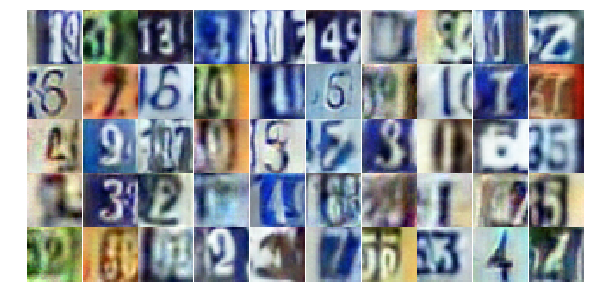

Epoch 23/25... Discriminator Loss: 0.6281... Generator Loss: 1.1072
Epoch 23/25... Discriminator Loss: 1.1956... Generator Loss: 0.5815
Epoch 23/25... Discriminator Loss: 0.6473... Generator Loss: 1.4109
Epoch 23/25... Discriminator Loss: 0.6422... Generator Loss: 1.1951
Epoch 23/25... Discriminator Loss: 0.4414... Generator Loss: 1.4369
Epoch 23/25... Discriminator Loss: 0.9572... Generator Loss: 0.7041
Epoch 23/25... Discriminator Loss: 1.1419... Generator Loss: 0.5701
Epoch 23/25... Discriminator Loss: 0.7257... Generator Loss: 2.4262
Epoch 23/25... Discriminator Loss: 0.7536... Generator Loss: 0.9417
Epoch 23/25... Discriminator Loss: 1.1757... Generator Loss: 0.6284


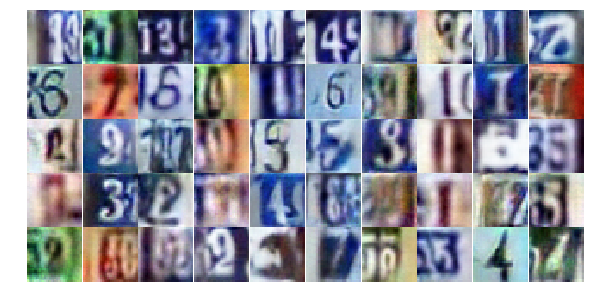

Epoch 23/25... Discriminator Loss: 1.1716... Generator Loss: 0.5774
Epoch 23/25... Discriminator Loss: 0.8521... Generator Loss: 0.7903
Epoch 23/25... Discriminator Loss: 1.1442... Generator Loss: 0.5332
Epoch 23/25... Discriminator Loss: 0.5947... Generator Loss: 1.2104
Epoch 23/25... Discriminator Loss: 0.7288... Generator Loss: 0.9878
Epoch 23/25... Discriminator Loss: 0.8204... Generator Loss: 0.8310
Epoch 23/25... Discriminator Loss: 0.7866... Generator Loss: 0.8844
Epoch 23/25... Discriminator Loss: 1.1233... Generator Loss: 0.5544
Epoch 23/25... Discriminator Loss: 0.6079... Generator Loss: 1.1531
Epoch 23/25... Discriminator Loss: 0.6716... Generator Loss: 1.2348


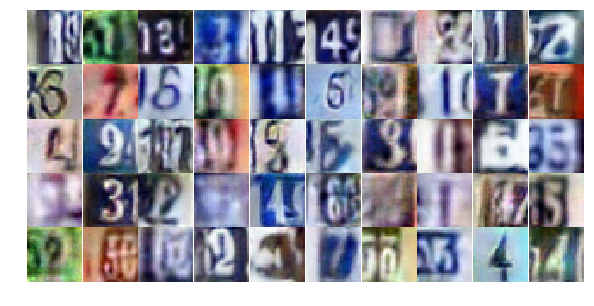

Epoch 23/25... Discriminator Loss: 0.5310... Generator Loss: 1.2571
Epoch 23/25... Discriminator Loss: 0.5673... Generator Loss: 1.1611
Epoch 23/25... Discriminator Loss: 0.6539... Generator Loss: 1.8942


In [ ]:
# Load the data and train the network here
dataset = Dataset(trainset, testset)
losses, samples = train(net, dataset, epochs, batch_size, figsize=(10,5))

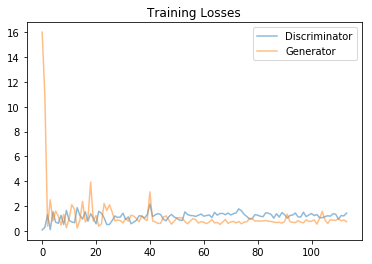

In [18]:
fig, ax = plt.subplots()
losses = np.array(losses)
plt.plot(losses.T[0], label='Discriminator', alpha=0.5)
plt.plot(losses.T[1], label='Generator', alpha=0.5)
plt.title("Training Losses")
plt.legend()

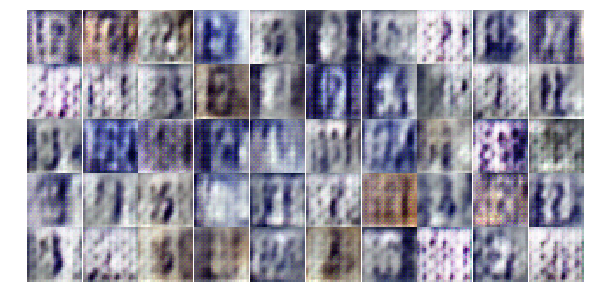

In [19]:
_ = view_samples(-1, samples, 5, 10, figsize=(10,5))